In [1]:
%run ./train_and_eval.py
%run ./plot_imputation.py
%run ./train_catboost_model.py
%run "C:/Users/aweaver/OneDrive - The Cincinnati Insurance Company/Small Business/Hit Ratio Model/synthetic_data/regression.py"
%run ./initial_impute.py
%run ./impute_with_trained_model.py

In [2]:
rawdf = generate_synthetic_data(n_samples=1000,
                            n_continuous=20,
                            n_categorical=0,
                            missing_fraction=0,
                            random_seed=42,
                            between_correlation=0.3)[0]
rawdf.head()

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19
0,1.505721,0.990525,1.329264,1.328106,0.398897,-0.333123,-0.638215,0.091707,0.649371,0.536957,-0.377842,0.825546,0.402454,1.434810,-1.295755,-0.527509,0.227319,1.036703,0.785815,-0.195308
1,-1.866027,-0.484633,-0.547891,-1.209723,0.434463,-0.176863,-0.529173,1.333603,-0.014219,-0.866179,-1.070481,-0.769482,0.926363,-1.044928,1.719770,0.049745,1.296157,-1.344117,-1.420998,-1.550845
2,0.030851,-0.000873,-0.564020,-1.310576,-0.236442,0.106927,-0.448318,0.638288,0.548933,-0.154334,-1.655902,-0.077179,-0.654353,-0.073134,-0.196699,0.922018,-0.594475,-0.109923,-0.685533,-0.524741
3,0.869102,1.560678,1.372245,0.352509,-0.218922,1.393281,-0.933860,-0.081335,1.003396,0.833190,0.127545,1.838660,0.537406,-0.719782,-0.248488,0.490987,0.450162,1.189648,0.984896,-0.277765
4,-0.407791,-1.393277,0.616689,0.042694,0.189928,-0.563939,2.405199,-0.151483,1.096422,1.213082,-0.248831,-0.791014,-0.076466,-1.188800,-1.455580,-0.260533,-0.610922,-0.888665,0.569978,0.302217


In [3]:
# randomly mask 20% of the data in the first 5 columns only (leave the others untouched)
df = rawdf.copy()
np.random.seed(42)
msk = np.random.binomial(1, 0.2, size=(df.shape[0], 5)).astype(bool)
for i in range(5):
    m = msk[:, i]
    df.iloc[:, i].loc[m] = np.nan
df.head(10)

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19
0,1.505721,NaN,1.329264,1.328106,0.398897,-0.333123,-0.638215,0.091707,0.649371,0.536957,-0.377842,0.825546,0.402454,1.434810,-1.295755,-0.527509,0.227319,1.036703,0.785815,-0.195308
1,-1.866027,-0.484633,NaN,-1.209723,0.434463,-0.176863,-0.529173,1.333603,-0.014219,-0.866179,-1.070481,-0.769482,0.926363,-1.044928,1.719770,0.049745,1.296157,-1.344117,-1.420998,-1.550845
2,0.030851,NaN,NaN,-1.310576,-0.236442,0.106927,-0.448318,0.638288,0.548933,-0.154334,-1.655902,-0.077179,-0.654353,-0.073134,-0.196699,0.922018,-0.594475,-0.109923,-0.685533,-0.524741
3,0.869102,1.560678,1.372245,0.352509,-0.218922,1.393281,-0.933860,-0.081335,1.003396,0.833190,0.127545,1.838660,0.537406,-0.719782,-0.248488,0.490987,0.450162,1.189648,0.984896,-0.277765
4,-0.407791,-1.393277,0.616689,0.042694,0.189928,-0.563939,2.405199,-0.151483,1.096422,1.213082,-0.248831,-0.791014,-0.076466,-1.188800,-1.455580,-0.260533,-0.610922,-0.888665,0.569978,0.302217
5,1.251125,-0.438134,-0.471322,-1.265895,0.966045,-1.244858,-1.333260,-0.685207,-0.746025,-1.700427,-1.455348,-0.015670,-0.469265,0.701091,-1.136231,0.729046,-0.682216,-0.261293,0.848129,0.521768
6,-2.889903,-2.383737,-1.568677,NaN,NaN,-0.290154,-0.758562,0.421672,0.182181,-0.103354,0.198570,-1.269296,-0.796297,-1.180256,0.267138,-1.397684,0.425680,-0.285558,0.394473,-1.680095
7,NaN,0.208871,-0.886527,-1.740542,-0.275100,0.359204,-0.902806,-0.301649,-0.665818,-1.471600,0.530293,1.543239,-1.796326,-1.261523,0.325485,-1.096143,0.006418,-1.160540,0.754532,0.692767
8,1.652660,0.569648,-0.675359,NaN,0.651615,0.240002,0.632566,1.597809,1.098591,0.296348,-0.505700,-0.024007,0.582028,0.895286,-2.616528,-0.427301,-0.783108,-1.392612,0.290534,2.362392
9,2.690905,0.961090,0.868811,1.442082,0.132524,1.353816,0.854662,0.630821,0.735432,0.006541,1.626614,2.176086,2.047681,0.789990,2.789532,1.223083,0.590697,0.831482,0.597458,1.770494


In [4]:
missing_mask = df.isnull()
missing_mask.head()

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19
0,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [5]:
def rmse(actual, predicted):
    return np.sqrt(np.mean((actual - predicted)**2))

def get_rmse(df1, df2, missing_mask, col):
    actual = df1[col].loc[missing_mask[col].values]
    predicted = df2[col].loc[missing_mask[col].values]
    return rmse(actual.values, predicted.values)

# get_rmse(rawdf, imputed_df2, missing_mask, 'feature_1')

In [6]:
import matplotlib.pyplot as plt

def plot_scatter_matrix(original_df, init_impute_df, imputed_df, bins=40, n_features=4, figsize=(20, 20), actual_df=None):
    original_df = to_pd_df(original_df)
    init_impute_df = to_pd_df(init_impute_df)
    imputed_df = to_pd_df(imputed_df)

    fig, ax = plt.subplots(n_features, n_features, figsize=figsize)
    for i in range(n_features):
        for j in range(n_features):
            col = original_df.columns.tolist()[i]
            if i != j:
                # regular scatter plot
                original_df.iloc[:, [i,j]].plot(kind='scatter', x=original_df.columns[i], y=original_df.columns[j], ax=ax[i,j], grid=True, marker="o", color="black", alpha=0.15, edgecolors='none', label="Original Data")

                missing_mask = original_df.isnull().iloc[:, [i, j]]
                init_impute = init_impute_df.iloc[:, [i, j]].loc[missing_mask.iloc[:, 0] | missing_mask.iloc[:, 1]]
                imputed = imputed_df.iloc[:, [i, j]].loc[missing_mask.iloc[:, 0] | missing_mask.iloc[:, 1]]
                if i < j:
                    ax[i,j].scatter(init_impute.iloc[:, 0], init_impute.iloc[:, 1], marker=".", color="red", label="Initial Imputation", alpha=0.5, edgecolors='none')
                else:
                    ax[i,j].scatter(imputed.iloc[:, 0], imputed.iloc[:, 1], marker=".", color="blue", label="Final Imputation", alpha=0.5, edgecolors='none')

                ax[i,j].set_xlim(original_df.iloc[:, i].min(), original_df.iloc[:, i].max())
                ax[i,j].set_ylim(original_df.iloc[:, j].min(), original_df.iloc[:, j].max())
                ax[i,j].legend(loc='upper right')

            else:
                missing_mask = original_df.isnull().iloc[:, [i, j]]
                original_df.iloc[:, i].plot(kind='kde', ax=ax[i,j], grid=True, color="black", ls="--", lw=2, label="Original Data")
                ax[i,j].hist(init_impute_df.iloc[:, i], color="red", alpha=0.3, label="Initial Imputation", histtype='stepfilled', edgecolor='none', density=True, bins=bins)
                ax[i,j].hist(imputed_df.iloc[:, i], color="blue", alpha=0.3, label="Final Imputation", histtype='stepfilled', edgecolor='none', density=True, bins=bins)
                ax[i,j].legend(loc='upper right')

                ax[i,j].set_ylim(0, 1)
                if actual_df is not None:
                    ax[i,j].set_title(f"RMSE: {get_rmse(actual_df, imputed_df, missing_mask, col):.3f}", fontsize=14)

    
    plt.show()

In [7]:
# plot_scatter_matrix(df, imputed_df, imputed_df2, n_features=3, bins=30)

In [8]:
# plot_initial_densities(df)

In [9]:
imputed_df = initial_impute(df)
imputed_df.head().collect()

feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17,feature_18,feature_19
f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
1.505721,0.07656,1.329264,1.328106,0.398897,-0.333123,-0.638215,0.091707,0.649371,0.536957,-0.377842,0.825546,0.402454,1.43481,-1.295755,-0.527509,0.227319,1.036703,0.785815,-0.195308
-1.866027,-0.484633,0.023771,-1.209723,0.434463,-0.176863,-0.529173,1.333603,-0.014219,-0.866179,-1.070481,-0.769482,0.926363,-1.044928,1.71977,0.049745,1.296157,-1.344117,-1.420998,-1.550845
0.030851,0.07656,0.023771,-1.310576,-0.236442,0.106927,-0.448318,0.638288,0.548933,-0.154334,-1.655902,-0.077179,-0.654353,-0.073134,-0.196699,0.922018,-0.594475,-0.109923,-0.685533,-0.524741
0.869102,1.560678,1.372245,0.352509,-0.218922,1.393281,-0.93386,-0.081335,1.003396,0.83319,0.127545,1.83866,0.537406,-0.719782,-0.248488,0.490987,0.450162,1.189648,0.984896,-0.277765
-0.407791,-1.393277,0.616689,0.042694,0.189928,-0.563939,2.405199,-0.151483,1.096422,1.213082,-0.248831,-0.791014,-0.076466,-1.1888,-1.45558,-0.260533,-0.610922,-0.888665,0.569978,0.302217


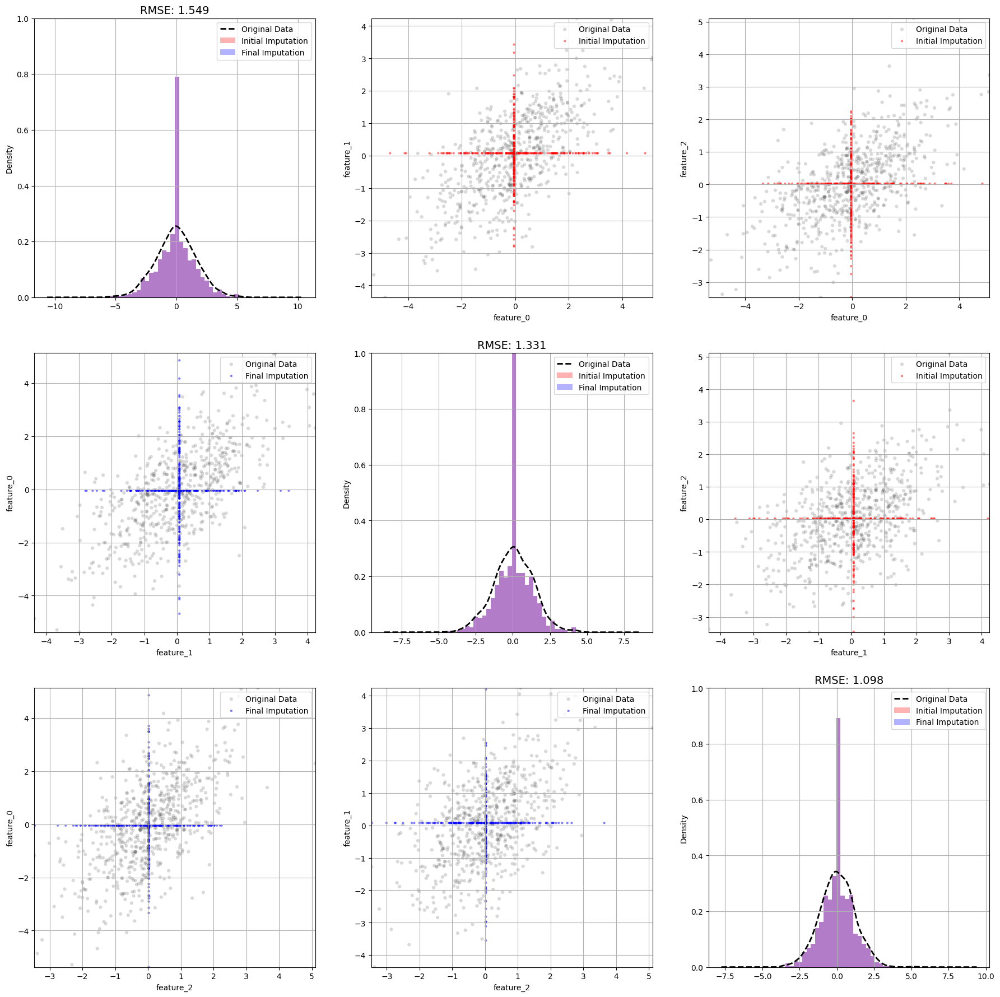

In [10]:
imputed_df2 = imputed_df.collect().to_pandas().copy()
plot_scatter_matrix(df, imputed_df, imputed_df2, n_features=3, bins=30, figsize=(22, 22), actual_df=rawdf)

Iteration 0 - Current RMSE: feature_0: 1.549, feature_1: 1.331, feature_2: 1.098


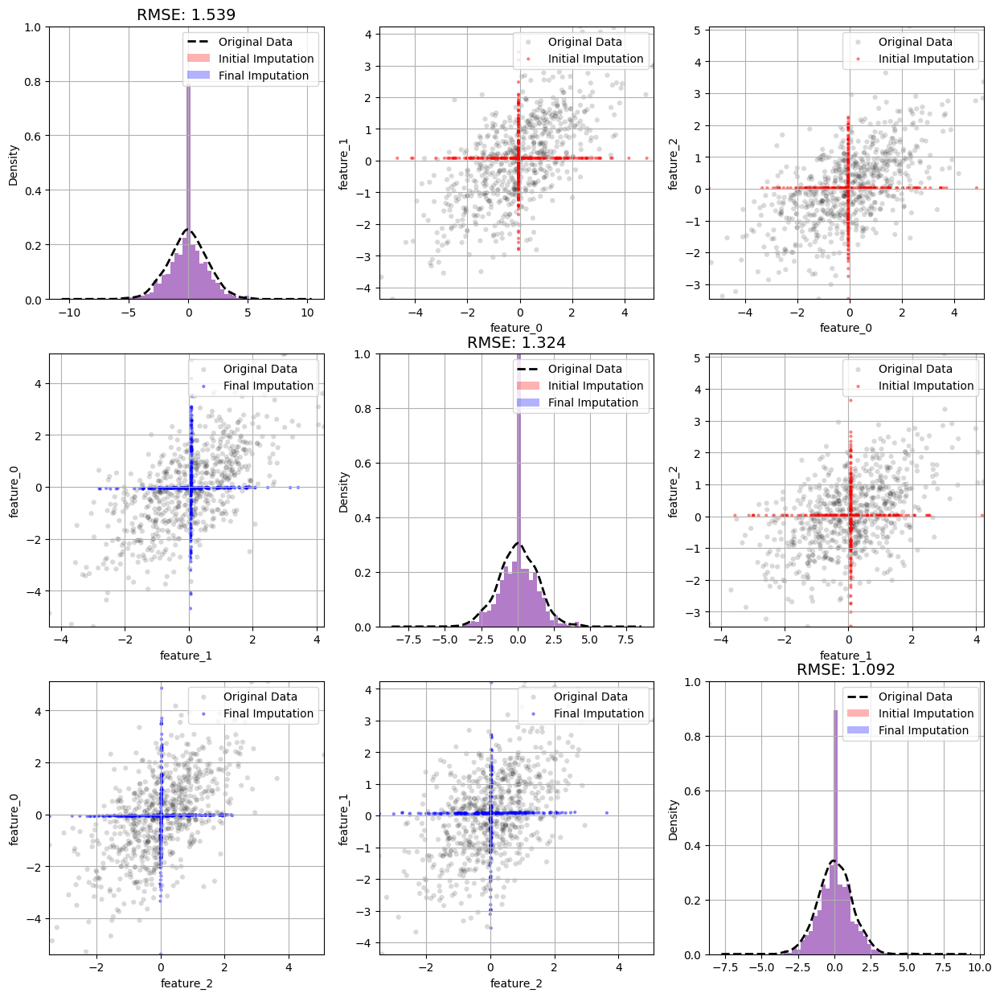

Iteration 1 - Current RMSE: feature_0: 1.539, feature_1: 1.324, feature_2: 1.092
Iteration 2 - Current RMSE: feature_0: 1.529, feature_1: 1.318, feature_2: 1.086
Iteration 3 - Current RMSE: feature_0: 1.519, feature_1: 1.312, feature_2: 1.079
Iteration 4 - Current RMSE: feature_0: 1.509, feature_1: 1.306, feature_2: 1.073
Iteration 5 - Current RMSE: feature_0: 1.499, feature_1: 1.301, feature_2: 1.066


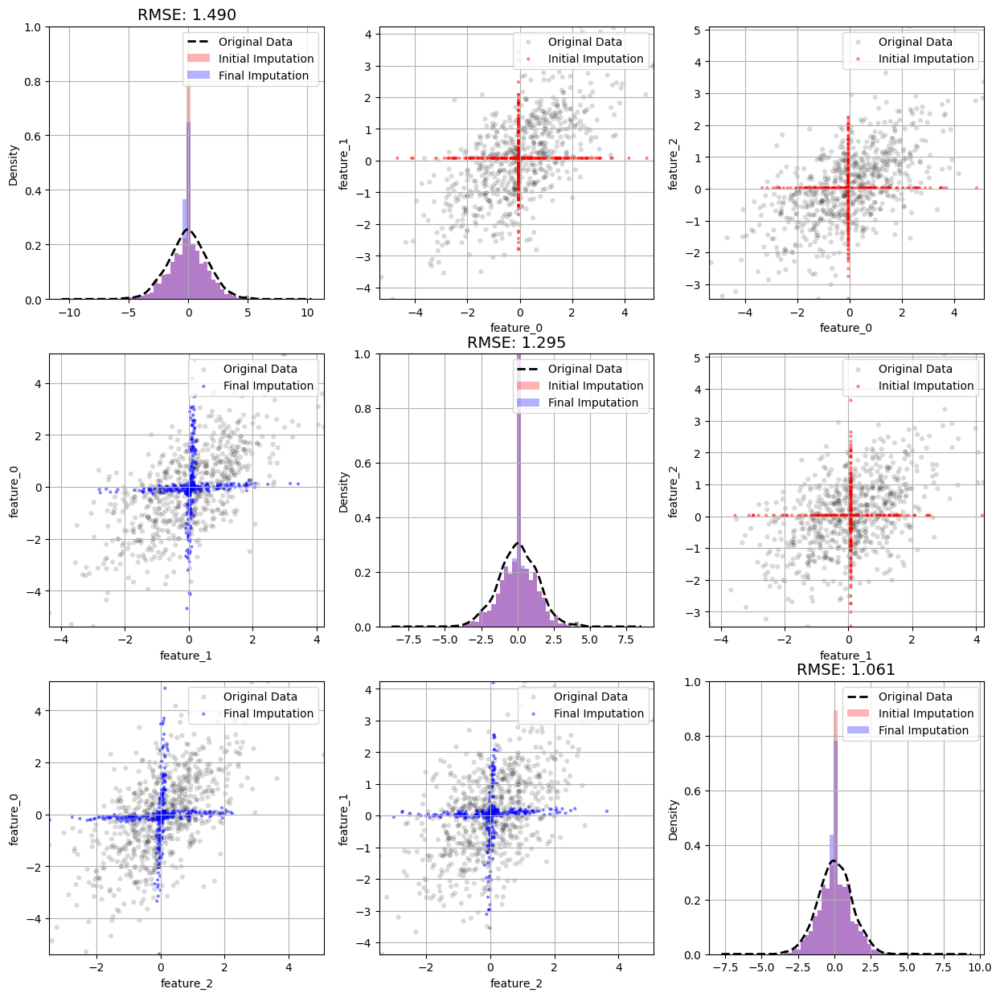

Iteration 6 - Current RMSE: feature_0: 1.490, feature_1: 1.295, feature_2: 1.061
Iteration 7 - Current RMSE: feature_0: 1.481, feature_1: 1.289, feature_2: 1.056
Iteration 8 - Current RMSE: feature_0: 1.473, feature_1: 1.284, feature_2: 1.050
Iteration 9 - Current RMSE: feature_0: 1.465, feature_1: 1.279, feature_2: 1.046
Iteration 10 - Current RMSE: feature_0: 1.456, feature_1: 1.274, feature_2: 1.041


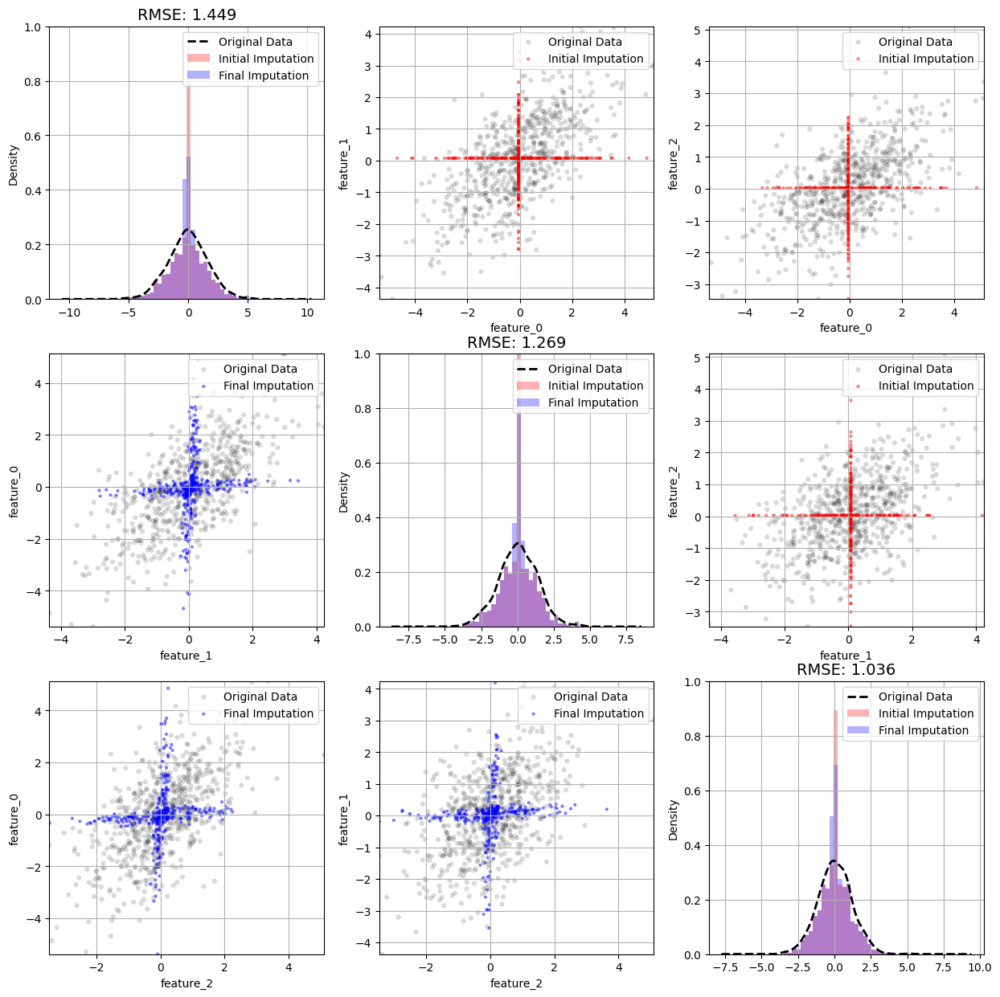

Iteration 11 - Current RMSE: feature_0: 1.449, feature_1: 1.269, feature_2: 1.036
Iteration 12 - Current RMSE: feature_0: 1.441, feature_1: 1.265, feature_2: 1.032
Iteration 13 - Current RMSE: feature_0: 1.434, feature_1: 1.261, feature_2: 1.027
Iteration 14 - Current RMSE: feature_0: 1.427, feature_1: 1.256, feature_2: 1.022
Iteration 15 - Current RMSE: feature_0: 1.419, feature_1: 1.251, feature_2: 1.018


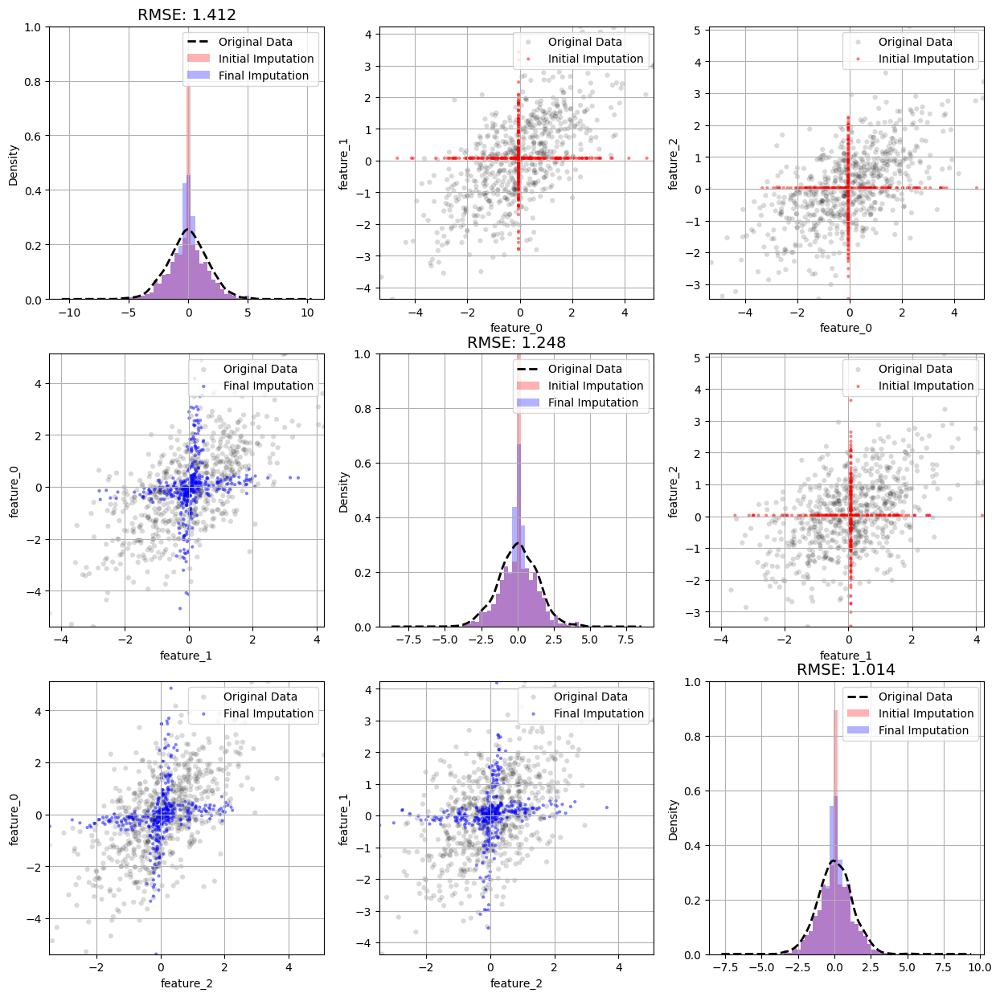

Iteration 16 - Current RMSE: feature_0: 1.412, feature_1: 1.248, feature_2: 1.014
Iteration 17 - Current RMSE: feature_0: 1.406, feature_1: 1.244, feature_2: 1.010
Iteration 18 - Current RMSE: feature_0: 1.399, feature_1: 1.240, feature_2: 1.006
Iteration 19 - Current RMSE: feature_0: 1.393, feature_1: 1.236, feature_2: 1.002
Iteration 20 - Current RMSE: feature_0: 1.387, feature_1: 1.232, feature_2: 0.998


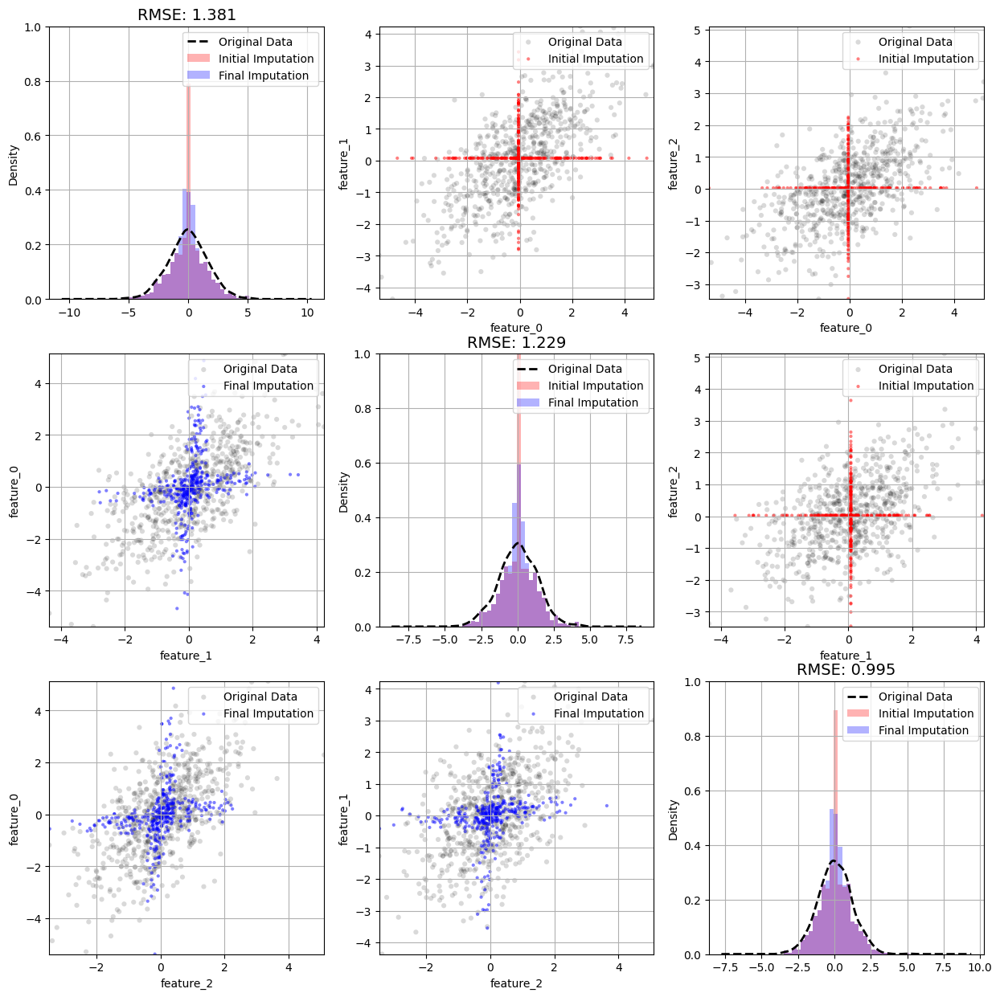

Iteration 21 - Current RMSE: feature_0: 1.381, feature_1: 1.229, feature_2: 0.995
Iteration 22 - Current RMSE: feature_0: 1.375, feature_1: 1.226, feature_2: 0.991
Iteration 23 - Current RMSE: feature_0: 1.369, feature_1: 1.223, feature_2: 0.988
Iteration 24 - Current RMSE: feature_0: 1.364, feature_1: 1.220, feature_2: 0.985
Iteration 25 - Current RMSE: feature_0: 1.359, feature_1: 1.217, feature_2: 0.982


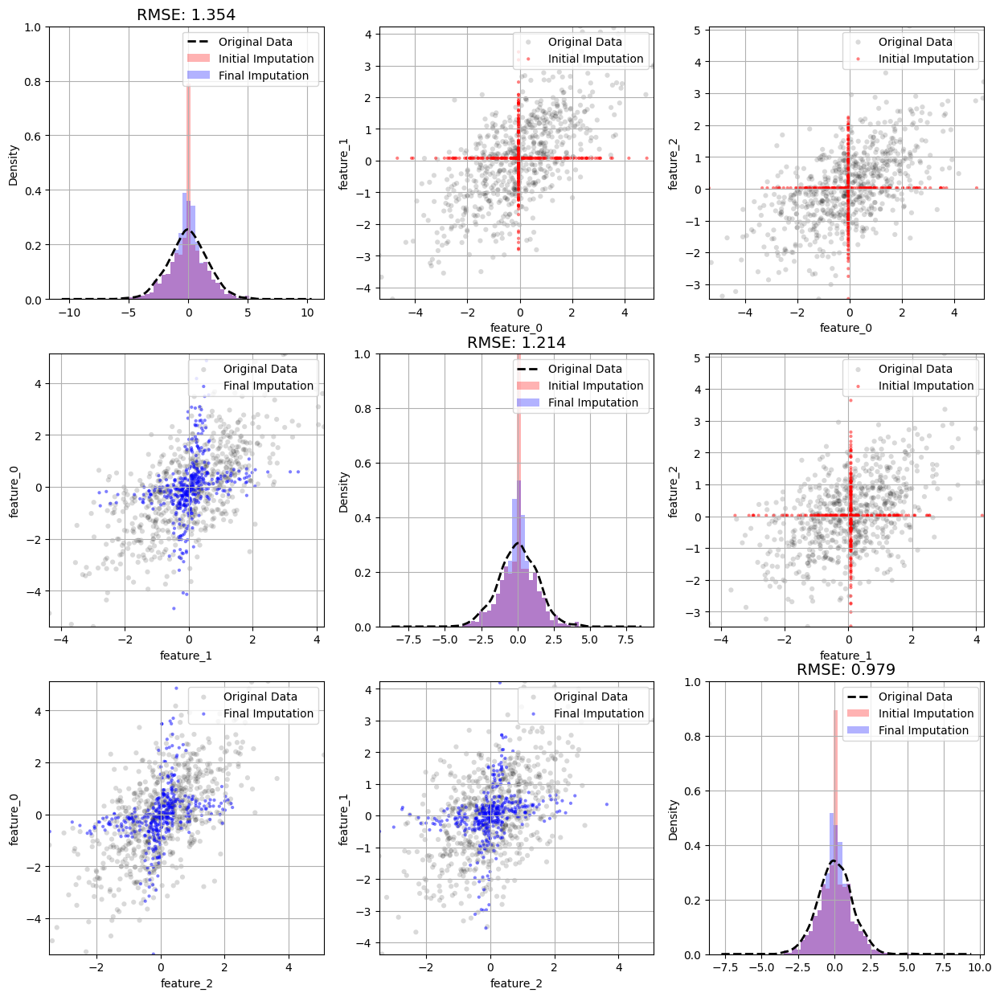

Iteration 26 - Current RMSE: feature_0: 1.354, feature_1: 1.214, feature_2: 0.979
Iteration 27 - Current RMSE: feature_0: 1.349, feature_1: 1.211, feature_2: 0.976
Iteration 28 - Current RMSE: feature_0: 1.344, feature_1: 1.209, feature_2: 0.974
Iteration 29 - Current RMSE: feature_0: 1.340, feature_1: 1.206, feature_2: 0.971
Iteration 30 - Current RMSE: feature_0: 1.335, feature_1: 1.203, feature_2: 0.968


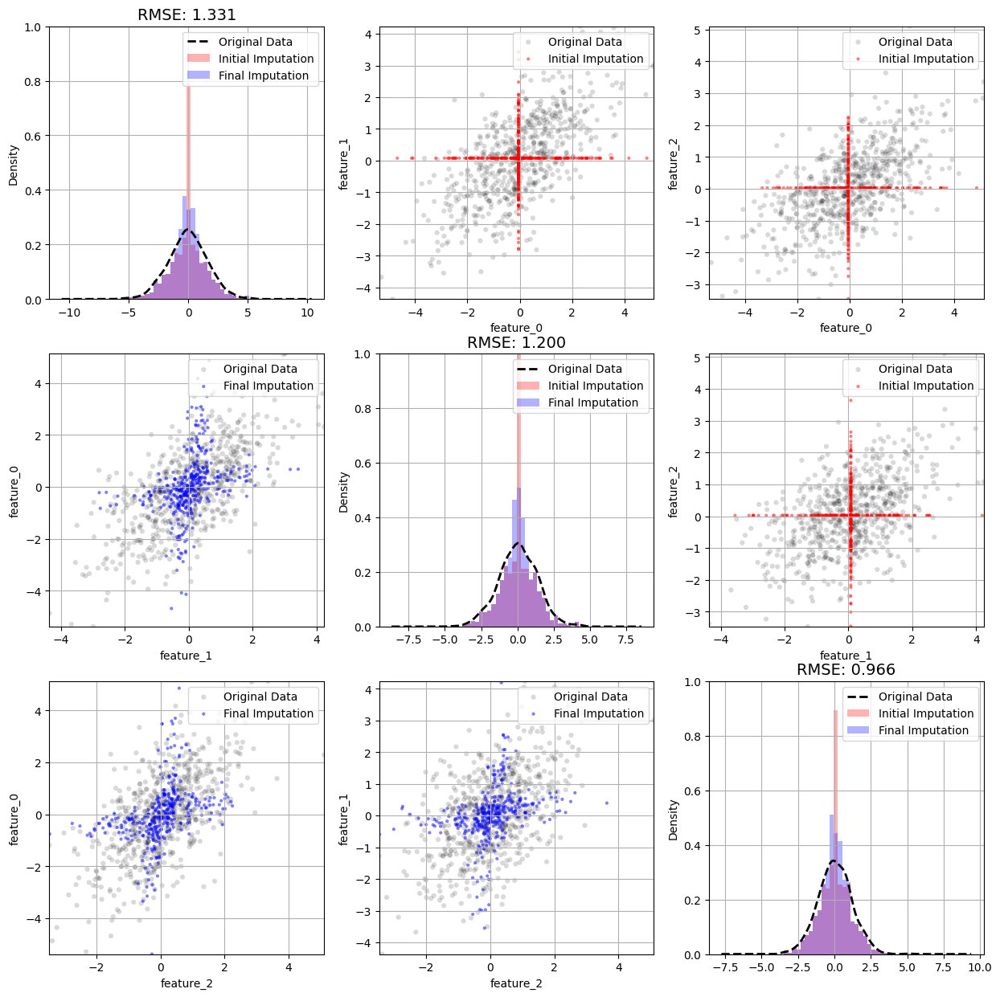

Iteration 31 - Current RMSE: feature_0: 1.331, feature_1: 1.200, feature_2: 0.966
Iteration 32 - Current RMSE: feature_0: 1.327, feature_1: 1.198, feature_2: 0.963
Iteration 33 - Current RMSE: feature_0: 1.323, feature_1: 1.195, feature_2: 0.961
Iteration 34 - Current RMSE: feature_0: 1.319, feature_1: 1.193, feature_2: 0.959
Iteration 35 - Current RMSE: feature_0: 1.316, feature_1: 1.190, feature_2: 0.957


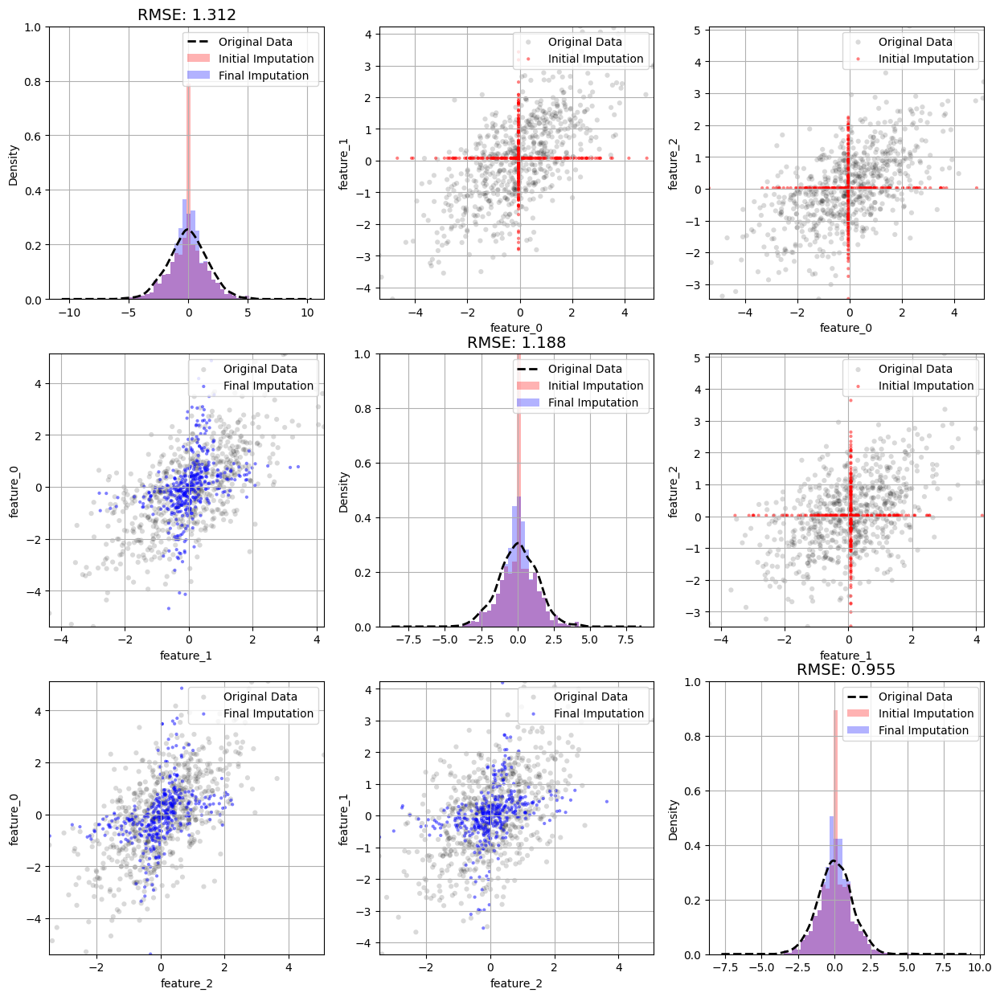

Iteration 36 - Current RMSE: feature_0: 1.312, feature_1: 1.188, feature_2: 0.955
Iteration 37 - Current RMSE: feature_0: 1.308, feature_1: 1.186, feature_2: 0.953
Iteration 38 - Current RMSE: feature_0: 1.305, feature_1: 1.184, feature_2: 0.951
Iteration 39 - Current RMSE: feature_0: 1.302, feature_1: 1.181, feature_2: 0.949
Iteration 40 - Current RMSE: feature_0: 1.298, feature_1: 1.179, feature_2: 0.947


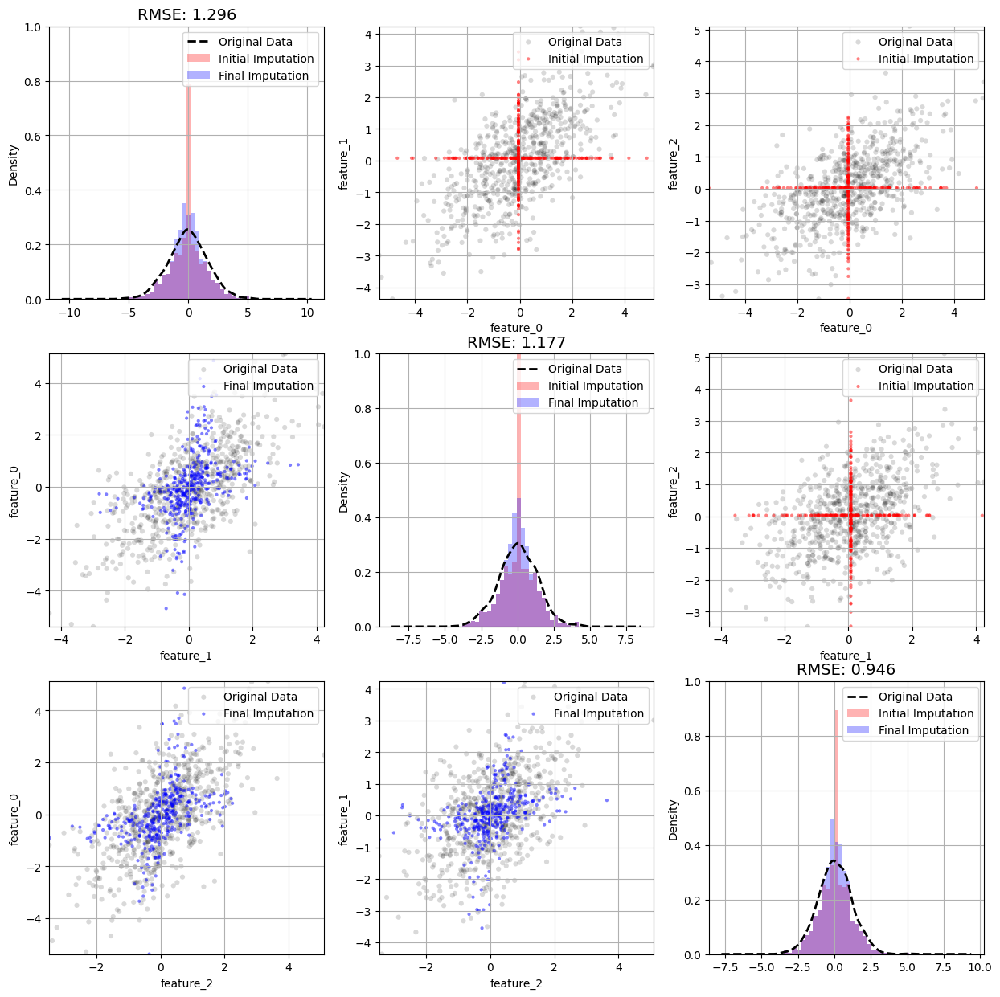

Iteration 41 - Current RMSE: feature_0: 1.296, feature_1: 1.177, feature_2: 0.946
Iteration 42 - Current RMSE: feature_0: 1.292, feature_1: 1.175, feature_2: 0.944
Iteration 43 - Current RMSE: feature_0: 1.289, feature_1: 1.173, feature_2: 0.943
Iteration 44 - Current RMSE: feature_0: 1.286, feature_1: 1.171, feature_2: 0.941
Iteration 45 - Current RMSE: feature_0: 1.284, feature_1: 1.169, feature_2: 0.939


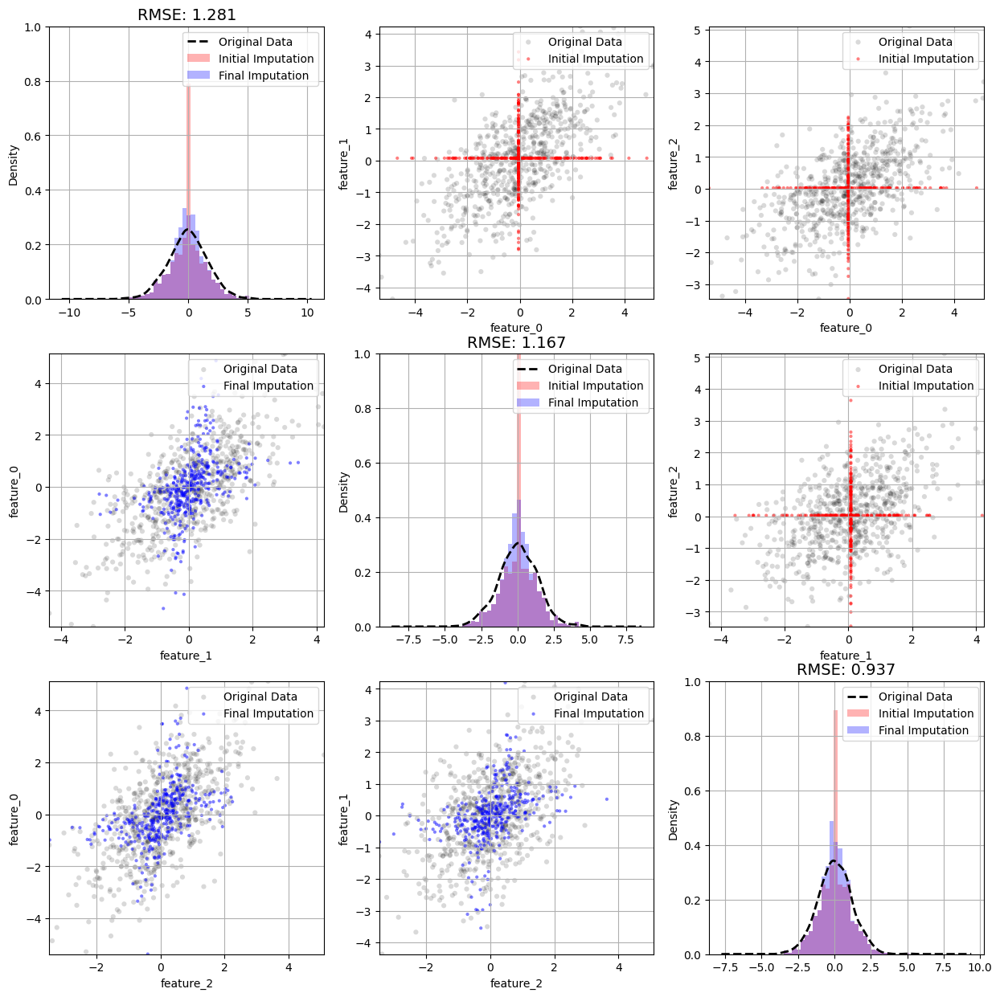

Iteration 46 - Current RMSE: feature_0: 1.281, feature_1: 1.167, feature_2: 0.937
Iteration 47 - Current RMSE: feature_0: 1.278, feature_1: 1.165, feature_2: 0.936
Iteration 48 - Current RMSE: feature_0: 1.275, feature_1: 1.163, feature_2: 0.934
Iteration 49 - Current RMSE: feature_0: 1.273, feature_1: 1.162, feature_2: 0.933
Iteration 50 - Current RMSE: feature_0: 1.271, feature_1: 1.160, feature_2: 0.931


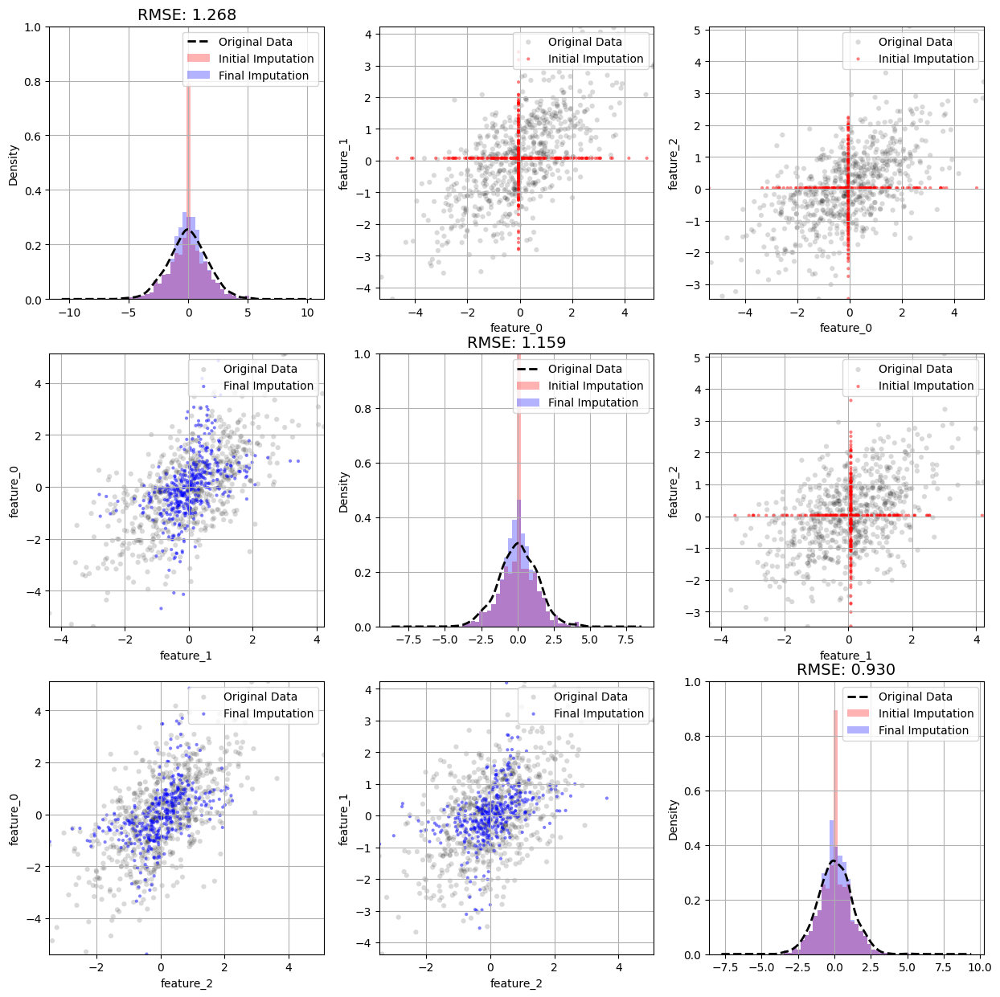

Iteration 51 - Current RMSE: feature_0: 1.268, feature_1: 1.159, feature_2: 0.930
Iteration 52 - Current RMSE: feature_0: 1.266, feature_1: 1.157, feature_2: 0.929
Iteration 53 - Current RMSE: feature_0: 1.264, feature_1: 1.155, feature_2: 0.927
Iteration 54 - Current RMSE: feature_0: 1.262, feature_1: 1.154, feature_2: 0.926
Iteration 55 - Current RMSE: feature_0: 1.260, feature_1: 1.152, feature_2: 0.925


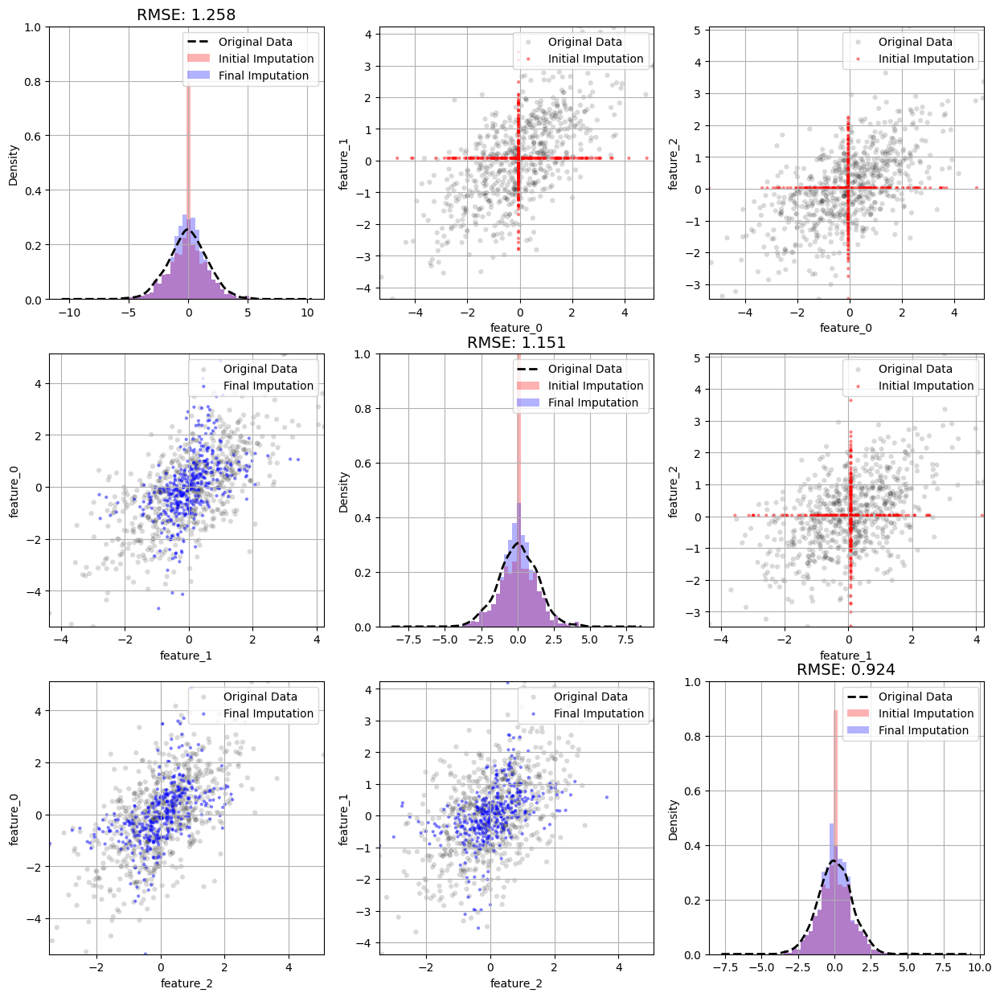

Iteration 56 - Current RMSE: feature_0: 1.258, feature_1: 1.151, feature_2: 0.924
Iteration 57 - Current RMSE: feature_0: 1.256, feature_1: 1.149, feature_2: 0.923
Iteration 58 - Current RMSE: feature_0: 1.254, feature_1: 1.148, feature_2: 0.922
Iteration 59 - Current RMSE: feature_0: 1.252, feature_1: 1.147, feature_2: 0.921
Iteration 60 - Current RMSE: feature_0: 1.251, feature_1: 1.145, feature_2: 0.920


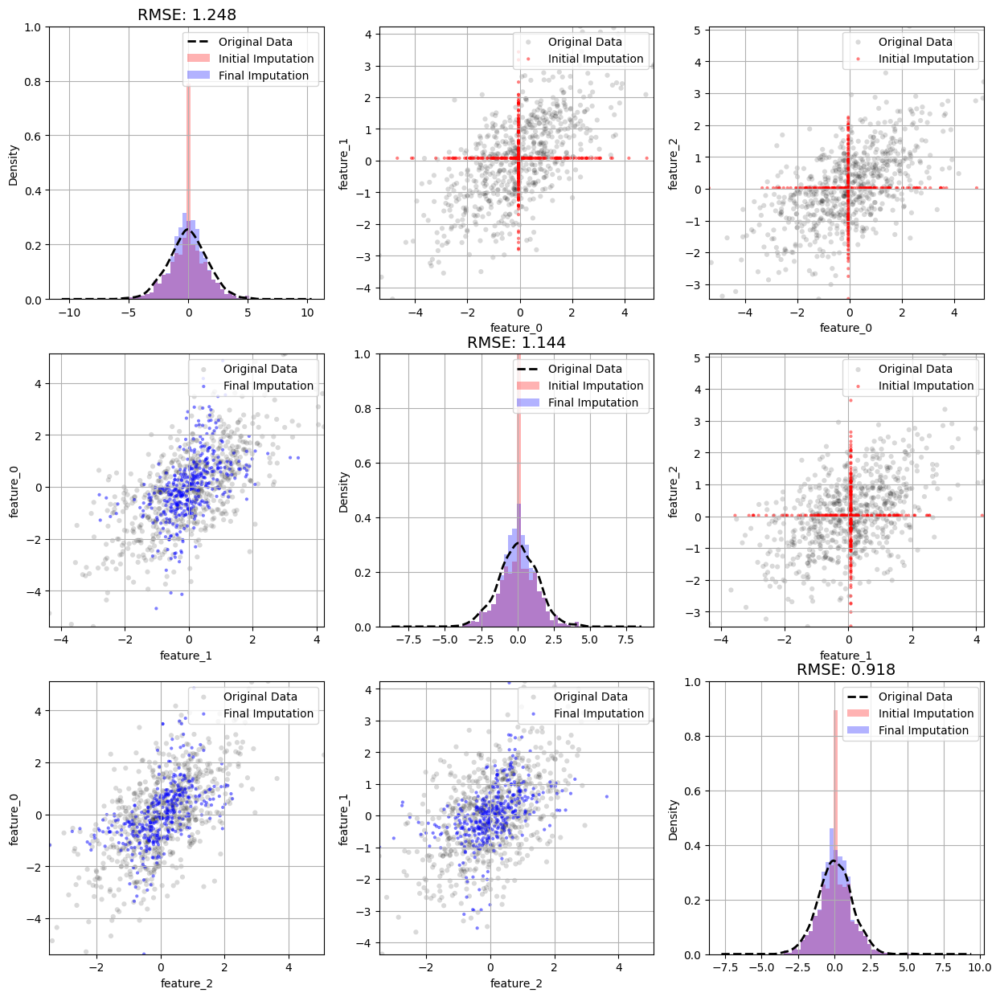

Iteration 61 - Current RMSE: feature_0: 1.248, feature_1: 1.144, feature_2: 0.918
Iteration 62 - Current RMSE: feature_0: 1.247, feature_1: 1.143, feature_2: 0.918
Iteration 63 - Current RMSE: feature_0: 1.245, feature_1: 1.142, feature_2: 0.917
Iteration 64 - Current RMSE: feature_0: 1.244, feature_1: 1.141, feature_2: 0.916
Iteration 65 - Current RMSE: feature_0: 1.242, feature_1: 1.139, feature_2: 0.914


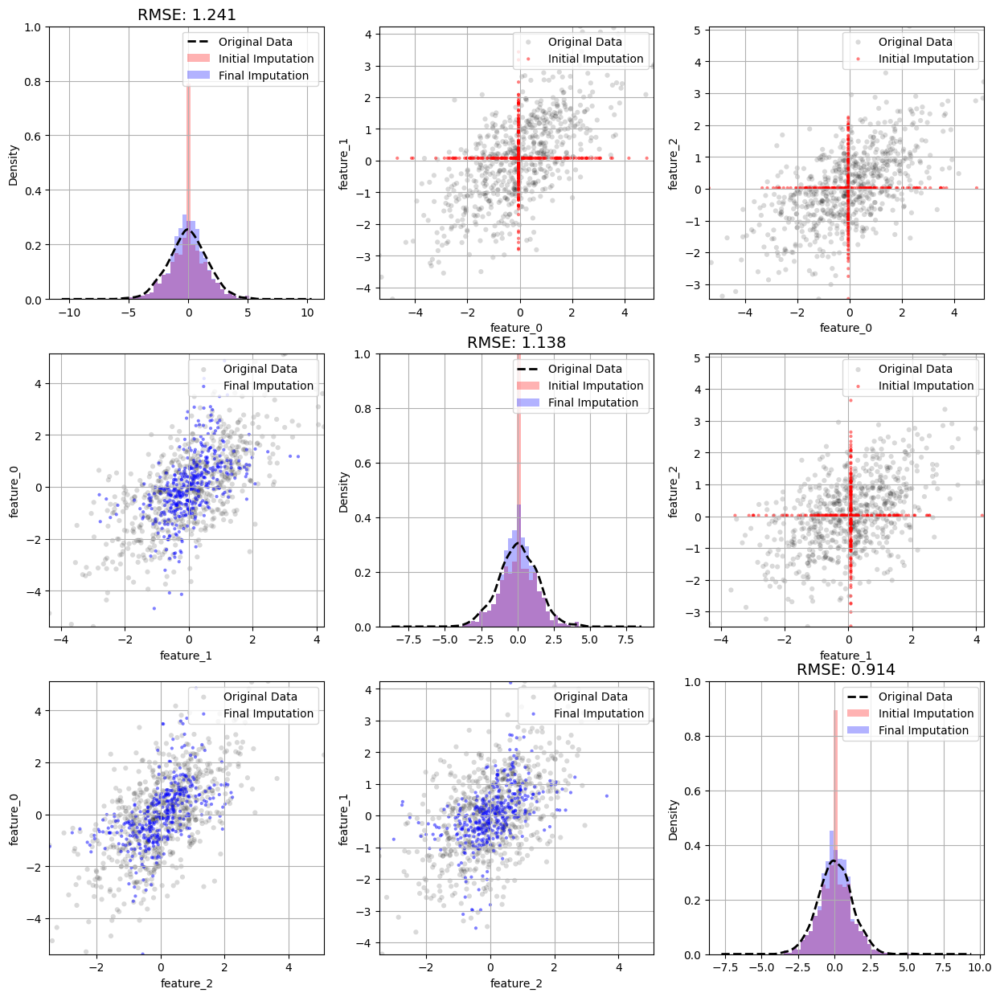

Iteration 66 - Current RMSE: feature_0: 1.241, feature_1: 1.138, feature_2: 0.914
Iteration 67 - Current RMSE: feature_0: 1.239, feature_1: 1.137, feature_2: 0.913
Iteration 68 - Current RMSE: feature_0: 1.238, feature_1: 1.136, feature_2: 0.912
Iteration 69 - Current RMSE: feature_0: 1.236, feature_1: 1.135, feature_2: 0.912
Iteration 70 - Current RMSE: feature_0: 1.235, feature_1: 1.134, feature_2: 0.911


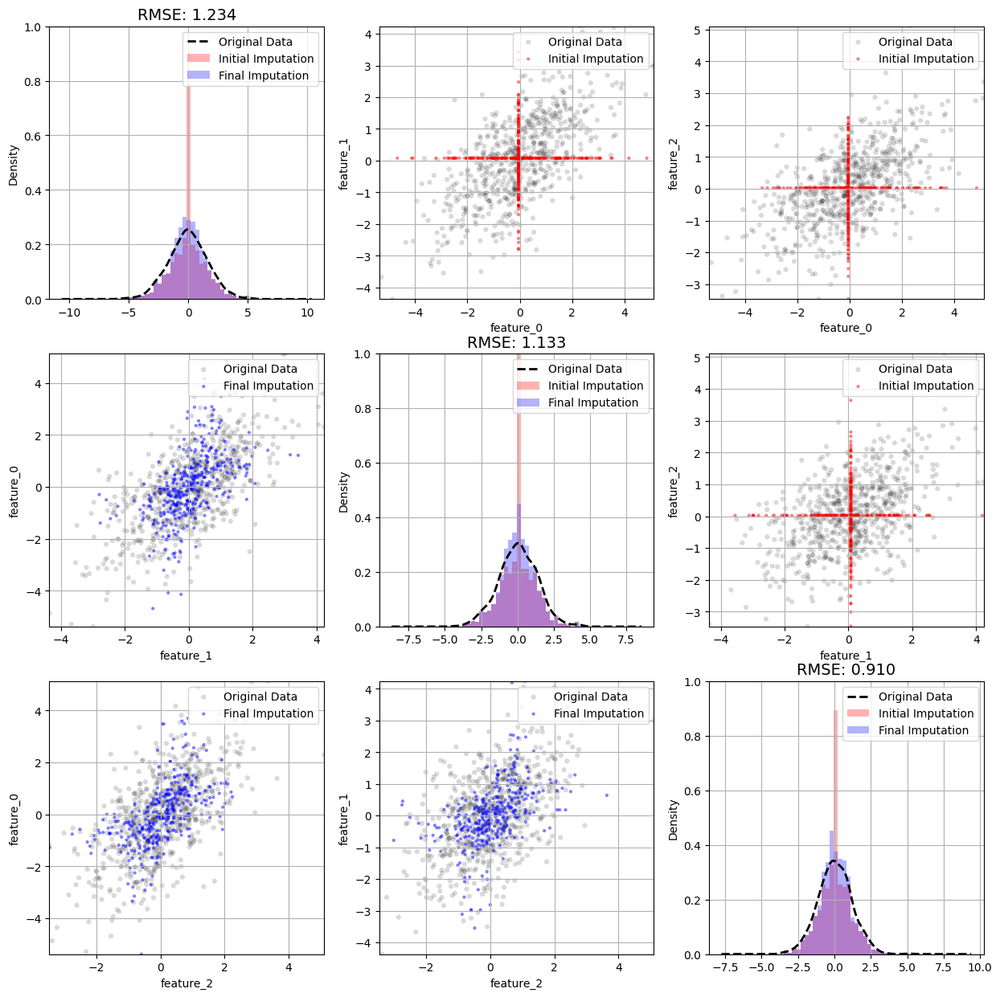

Iteration 71 - Current RMSE: feature_0: 1.234, feature_1: 1.133, feature_2: 0.910
Iteration 72 - Current RMSE: feature_0: 1.233, feature_1: 1.132, feature_2: 0.910
Iteration 73 - Current RMSE: feature_0: 1.232, feature_1: 1.131, feature_2: 0.909
Iteration 74 - Current RMSE: feature_0: 1.231, feature_1: 1.130, feature_2: 0.908
Iteration 75 - Current RMSE: feature_0: 1.230, feature_1: 1.130, feature_2: 0.908


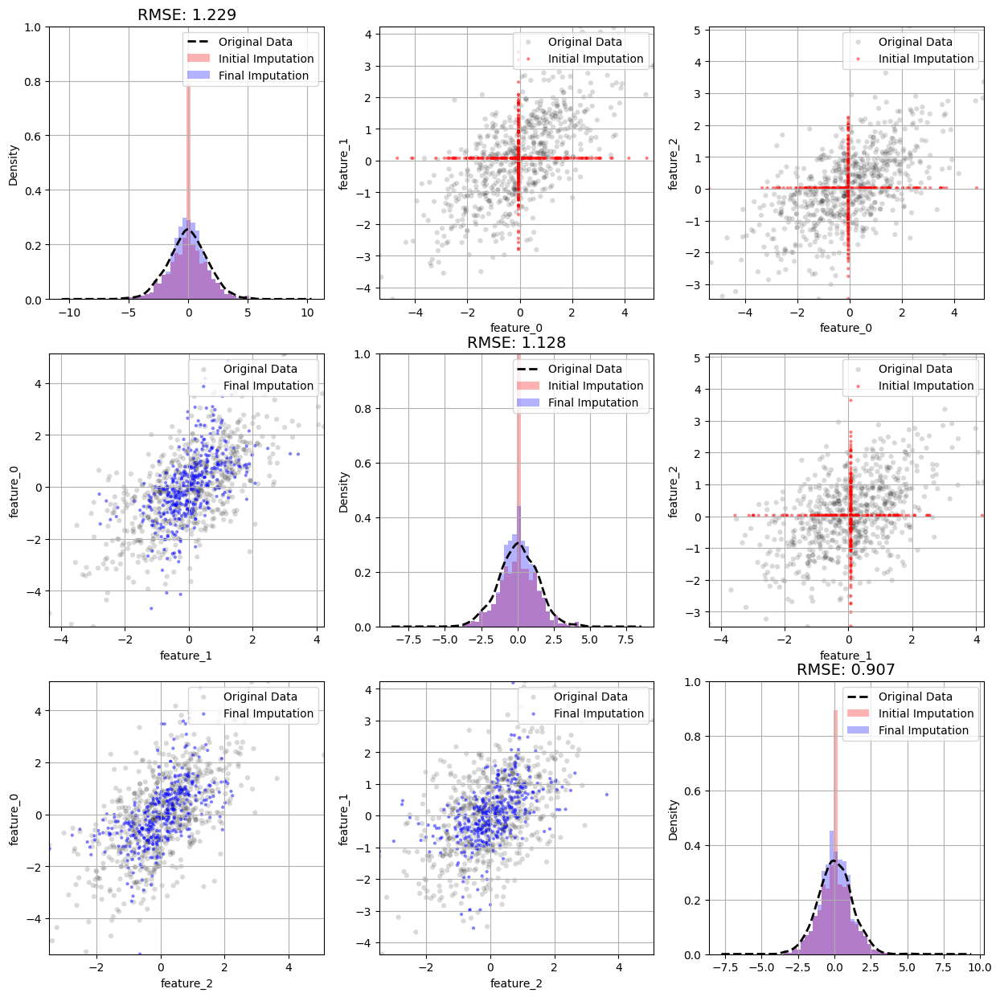

Iteration 76 - Current RMSE: feature_0: 1.229, feature_1: 1.128, feature_2: 0.907
Iteration 77 - Current RMSE: feature_0: 1.228, feature_1: 1.127, feature_2: 0.907
Iteration 78 - Current RMSE: feature_0: 1.227, feature_1: 1.126, feature_2: 0.906
Iteration 79 - Current RMSE: feature_0: 1.226, feature_1: 1.126, feature_2: 0.906
Iteration 80 - Current RMSE: feature_0: 1.225, feature_1: 1.125, feature_2: 0.905


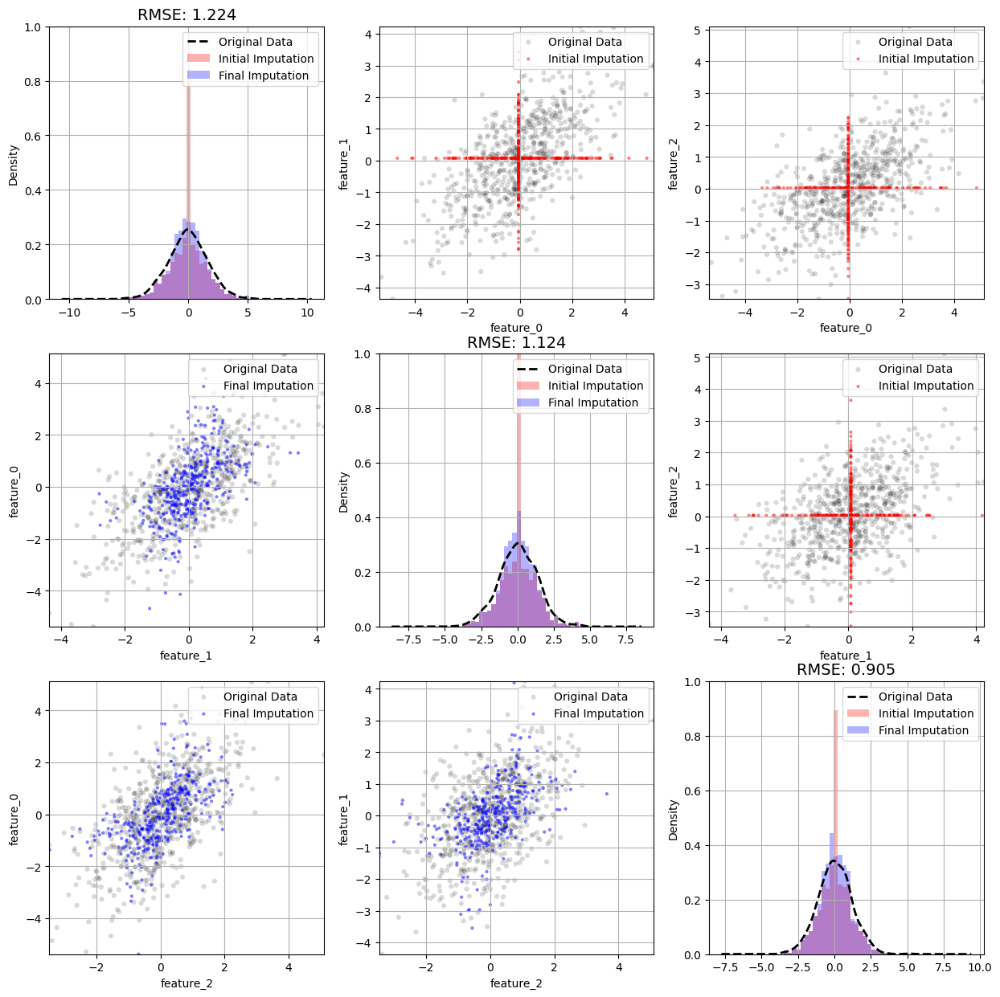

Iteration 81 - Current RMSE: feature_0: 1.224, feature_1: 1.124, feature_2: 0.905
Iteration 82 - Current RMSE: feature_0: 1.223, feature_1: 1.123, feature_2: 0.904
Iteration 83 - Current RMSE: feature_0: 1.222, feature_1: 1.123, feature_2: 0.904
Iteration 84 - Current RMSE: feature_0: 1.221, feature_1: 1.122, feature_2: 0.903
Iteration 85 - Current RMSE: feature_0: 1.220, feature_1: 1.121, feature_2: 0.903


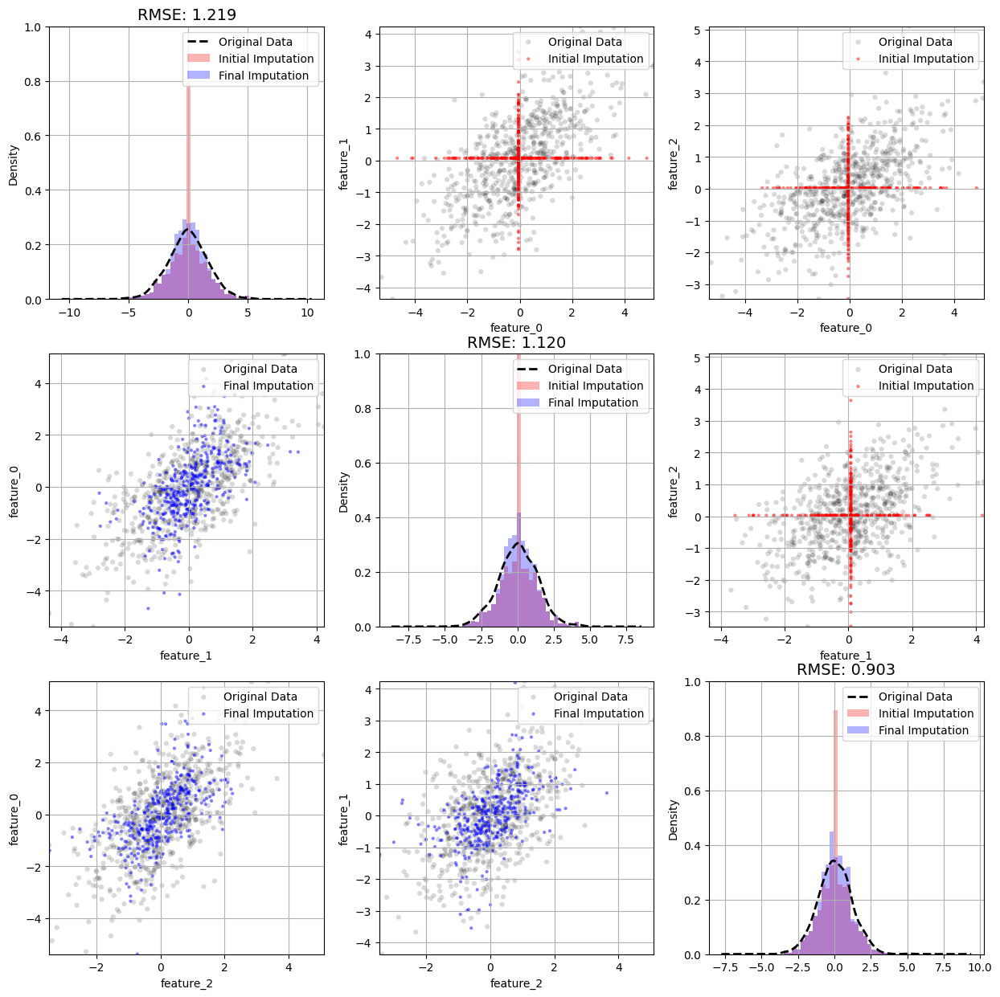

Iteration 86 - Current RMSE: feature_0: 1.219, feature_1: 1.120, feature_2: 0.903
Iteration 87 - Current RMSE: feature_0: 1.219, feature_1: 1.120, feature_2: 0.902
Iteration 88 - Current RMSE: feature_0: 1.218, feature_1: 1.119, feature_2: 0.902
Iteration 89 - Current RMSE: feature_0: 1.217, feature_1: 1.119, feature_2: 0.902
Iteration 90 - Current RMSE: feature_0: 1.216, feature_1: 1.118, feature_2: 0.901


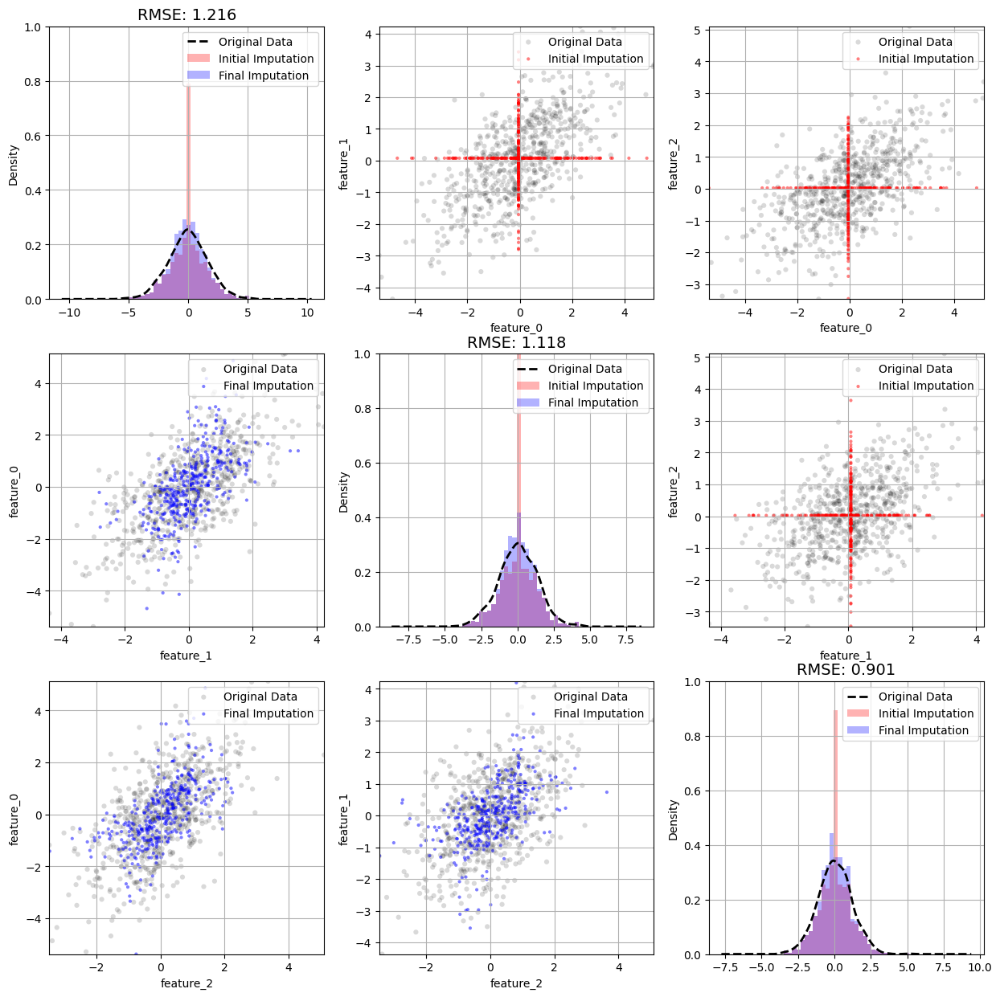

Iteration 91 - Current RMSE: feature_0: 1.216, feature_1: 1.118, feature_2: 0.901
Iteration 92 - Current RMSE: feature_0: 1.215, feature_1: 1.117, feature_2: 0.901
Iteration 93 - Current RMSE: feature_0: 1.214, feature_1: 1.117, feature_2: 0.900
Iteration 94 - Current RMSE: feature_0: 1.214, feature_1: 1.117, feature_2: 0.900
Iteration 95 - Current RMSE: feature_0: 1.214, feature_1: 1.116, feature_2: 0.900


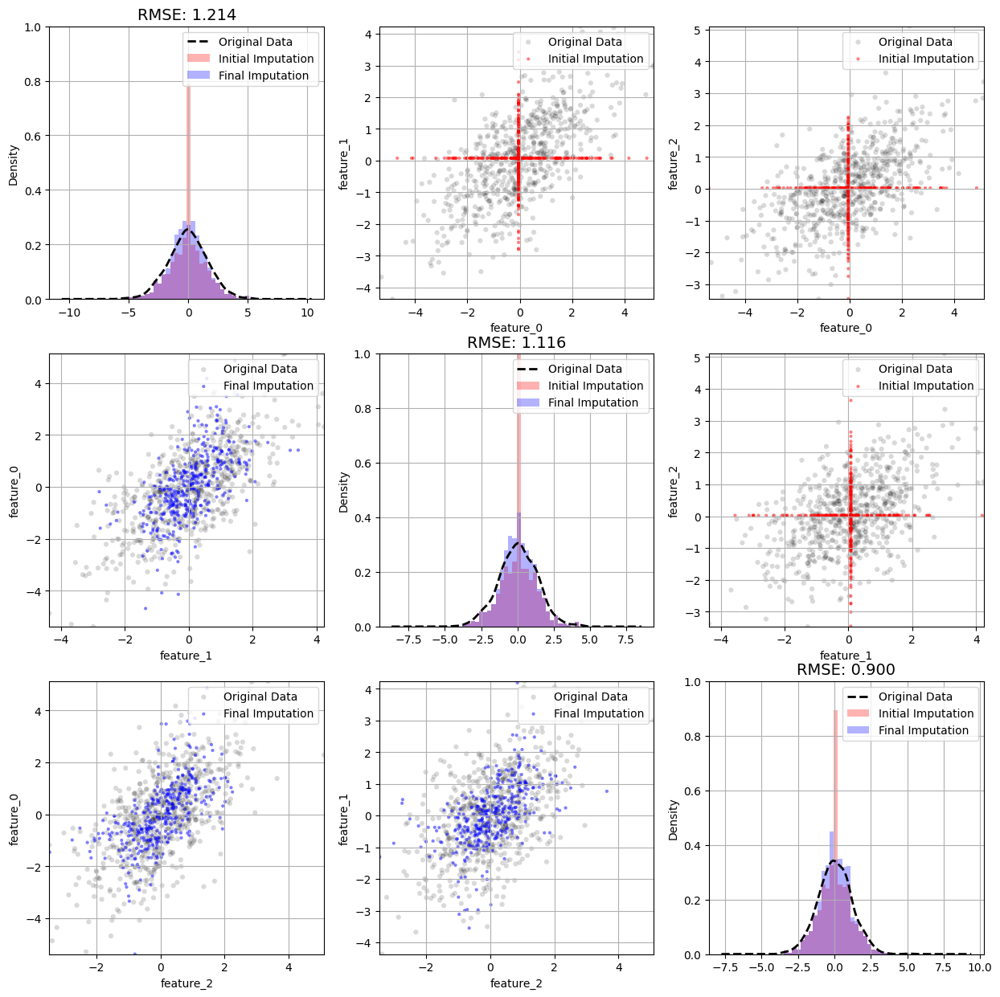

Iteration 96 - Current RMSE: feature_0: 1.214, feature_1: 1.116, feature_2: 0.900
Iteration 97 - Current RMSE: feature_0: 1.214, feature_1: 1.115, feature_2: 0.900
Iteration 98 - Current RMSE: feature_0: 1.213, feature_1: 1.115, feature_2: 0.900
Iteration 99 - Current RMSE: feature_0: 1.212, feature_1: 1.114, feature_2: 0.900


In [11]:
rmse_s = {
    'feature_0':[],
    'feature_1':[],
    'feature_2':[]
}
for i in range(100):
    rmse_s['feature_0'] += [get_rmse(rawdf, imputed_df2, missing_mask, 'feature_0')]
    rmse_s['feature_1'] += [get_rmse(rawdf, imputed_df2, missing_mask, 'feature_1')]
    rmse_s['feature_2'] += [get_rmse(rawdf, imputed_df2, missing_mask, 'feature_2')]
    
    print(f"Iteration {i} - Current RMSE: feature_0: {get_rmse(rawdf, imputed_df2, missing_mask, 'feature_0'):.3f}, feature_1: {get_rmse(rawdf, imputed_df2, missing_mask, 'feature_1'):.3f}, feature_2: {get_rmse(rawdf, imputed_df2, missing_mask, 'feature_2'):.3f}")

    models = train_catboost_model(imputed_df2, missing_mask)
    imputed_df2 = impute_with_trained_model(imputed_df2, missing_mask, models)

    if i % 5 == 0:
        plot_scatter_matrix(df, imputed_df, imputed_df2, n_features=3, bins=30, figsize=(15, 15), actual_df=rawdf)

Iteration 100 - Current RMSE: feature_0: 1.212, feature_1: 1.113, feature_2: 0.899


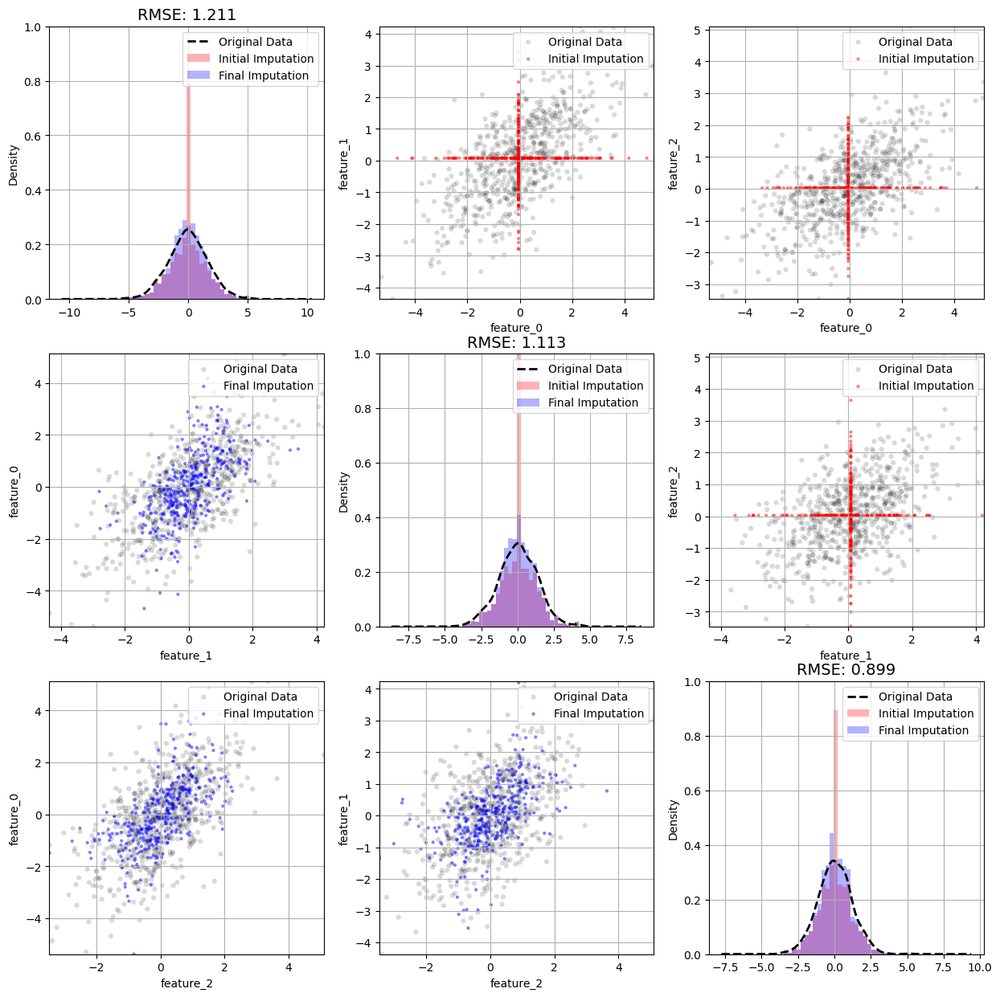

Iteration 101 - Current RMSE: feature_0: 1.211, feature_1: 1.113, feature_2: 0.899
Iteration 102 - Current RMSE: feature_0: 1.210, feature_1: 1.112, feature_2: 0.899
Iteration 103 - Current RMSE: feature_0: 1.210, feature_1: 1.112, feature_2: 0.899
Iteration 104 - Current RMSE: feature_0: 1.210, feature_1: 1.111, feature_2: 0.899
Iteration 105 - Current RMSE: feature_0: 1.209, feature_1: 1.111, feature_2: 0.899


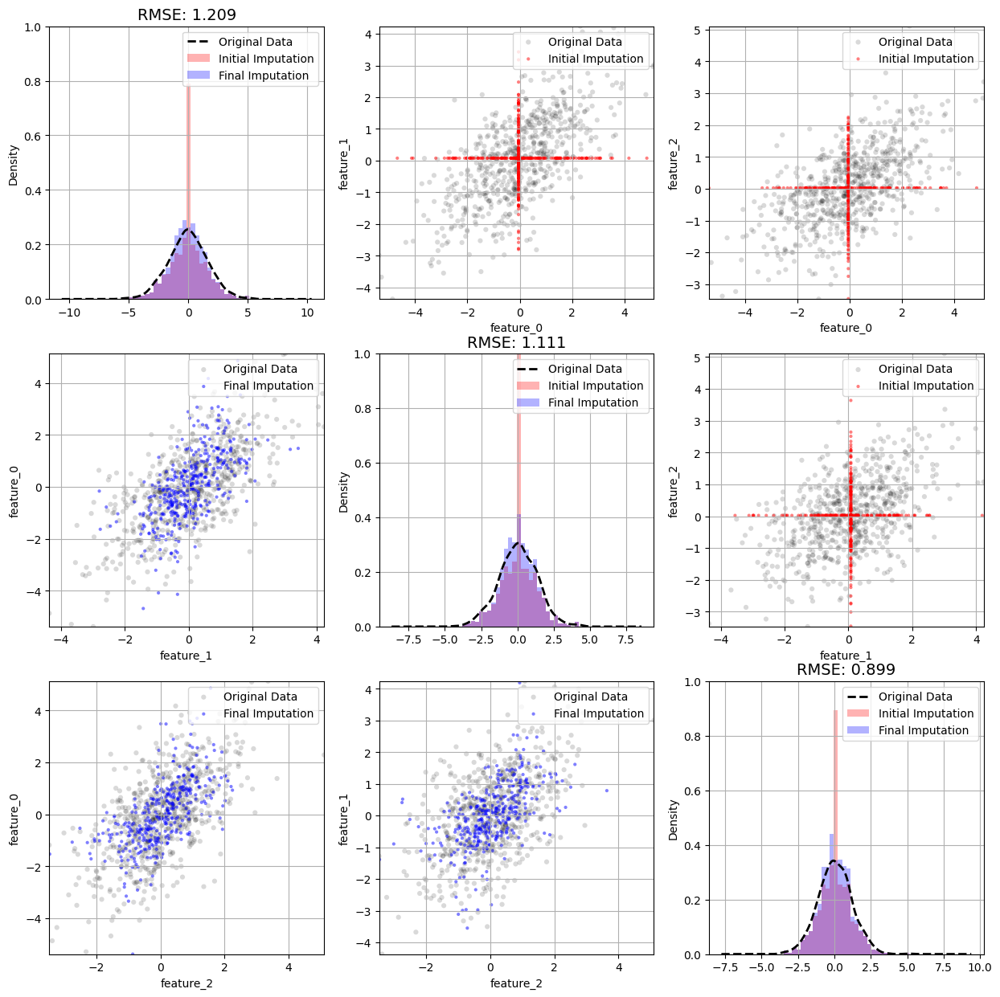

Iteration 106 - Current RMSE: feature_0: 1.209, feature_1: 1.111, feature_2: 0.899
Iteration 107 - Current RMSE: feature_0: 1.209, feature_1: 1.110, feature_2: 0.899
Iteration 108 - Current RMSE: feature_0: 1.209, feature_1: 1.110, feature_2: 0.899
Iteration 109 - Current RMSE: feature_0: 1.208, feature_1: 1.110, feature_2: 0.899
Iteration 110 - Current RMSE: feature_0: 1.208, feature_1: 1.109, feature_2: 0.899


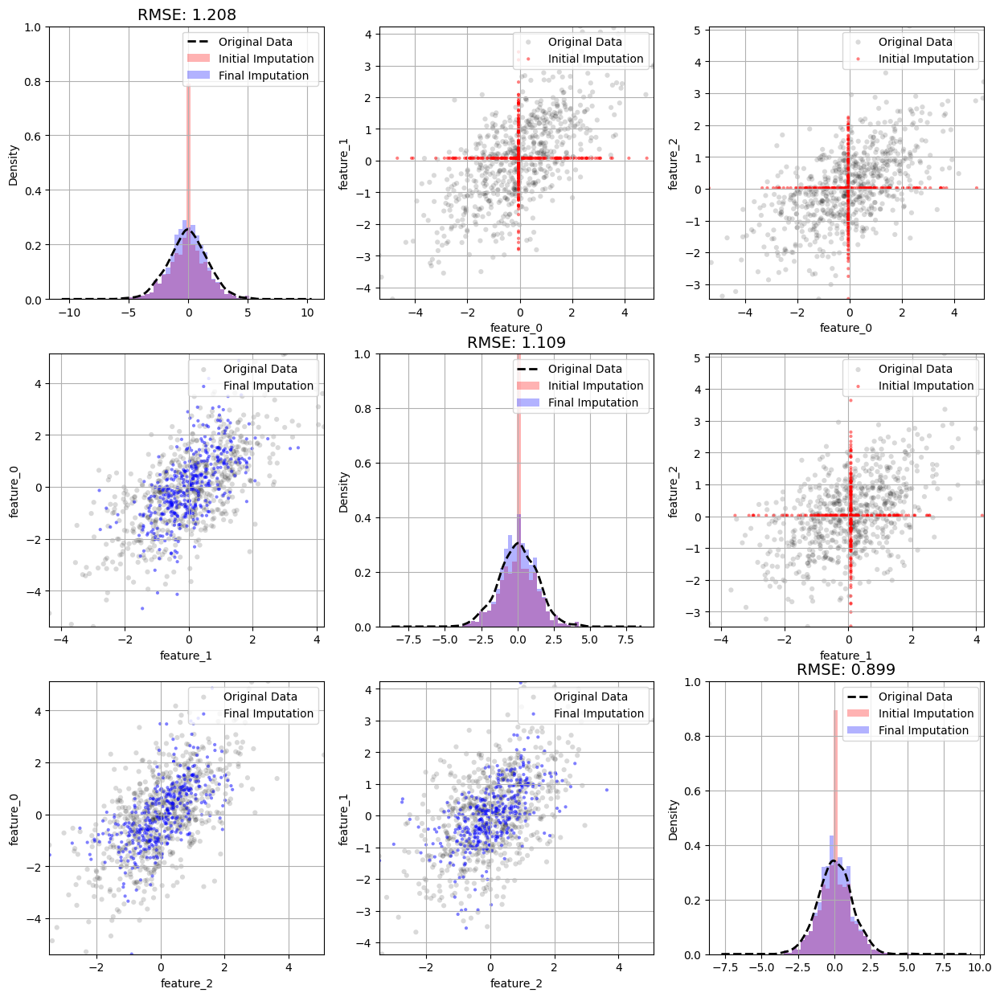

Iteration 111 - Current RMSE: feature_0: 1.208, feature_1: 1.109, feature_2: 0.899
Iteration 112 - Current RMSE: feature_0: 1.208, feature_1: 1.108, feature_2: 0.899
Iteration 113 - Current RMSE: feature_0: 1.208, feature_1: 1.108, feature_2: 0.899
Iteration 114 - Current RMSE: feature_0: 1.207, feature_1: 1.108, feature_2: 0.899
Iteration 115 - Current RMSE: feature_0: 1.207, feature_1: 1.108, feature_2: 0.899


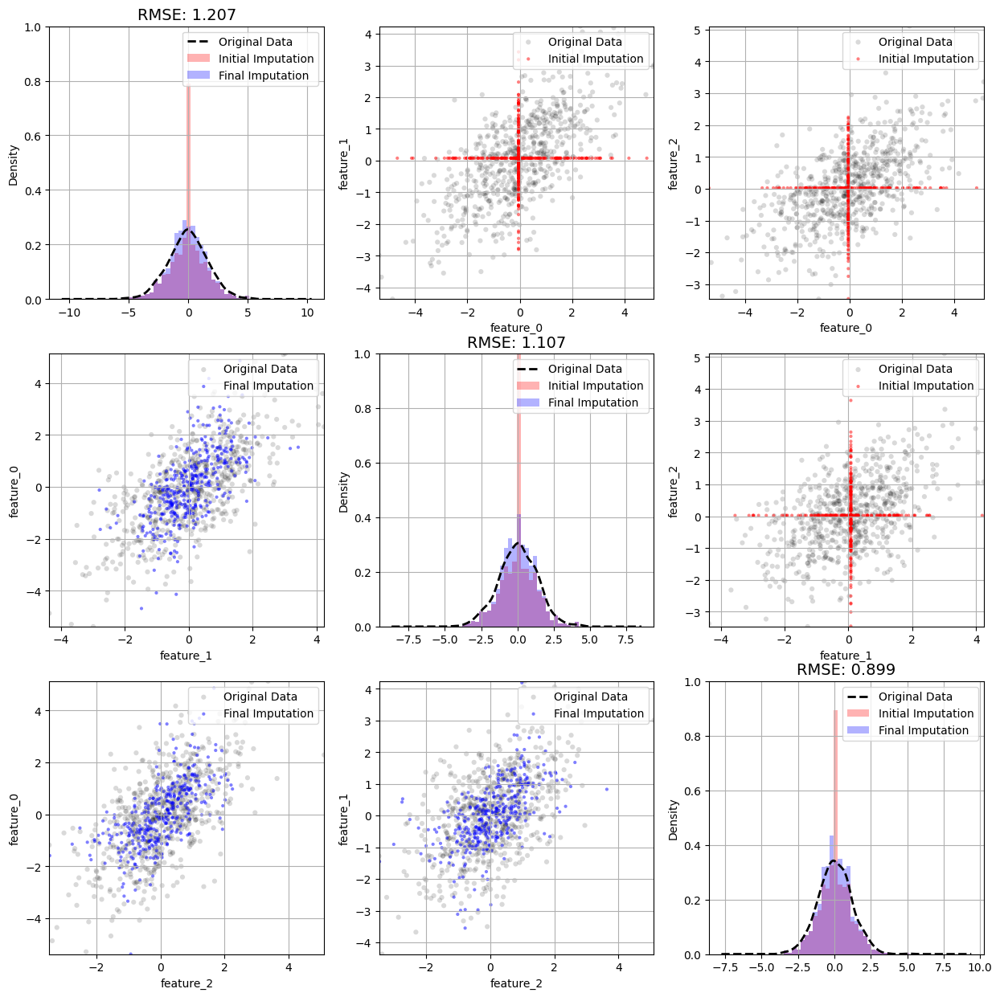

Iteration 116 - Current RMSE: feature_0: 1.207, feature_1: 1.107, feature_2: 0.899
Iteration 117 - Current RMSE: feature_0: 1.207, feature_1: 1.107, feature_2: 0.899
Iteration 118 - Current RMSE: feature_0: 1.207, feature_1: 1.107, feature_2: 0.899
Iteration 119 - Current RMSE: feature_0: 1.207, feature_1: 1.107, feature_2: 0.899
Iteration 120 - Current RMSE: feature_0: 1.207, feature_1: 1.107, feature_2: 0.898


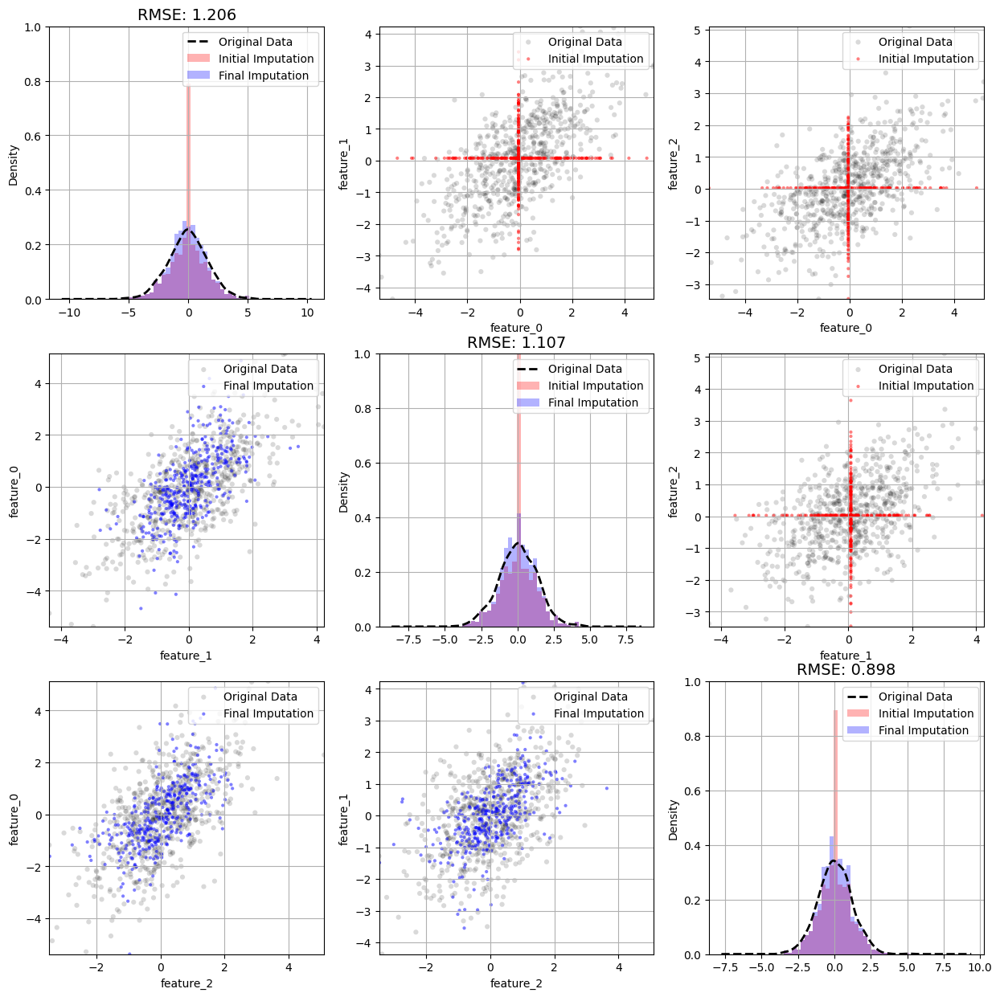

Iteration 121 - Current RMSE: feature_0: 1.206, feature_1: 1.107, feature_2: 0.898
Iteration 122 - Current RMSE: feature_0: 1.205, feature_1: 1.106, feature_2: 0.898
Iteration 123 - Current RMSE: feature_0: 1.205, feature_1: 1.106, feature_2: 0.898
Iteration 124 - Current RMSE: feature_0: 1.205, feature_1: 1.106, feature_2: 0.898
Iteration 125 - Current RMSE: feature_0: 1.204, feature_1: 1.106, feature_2: 0.898


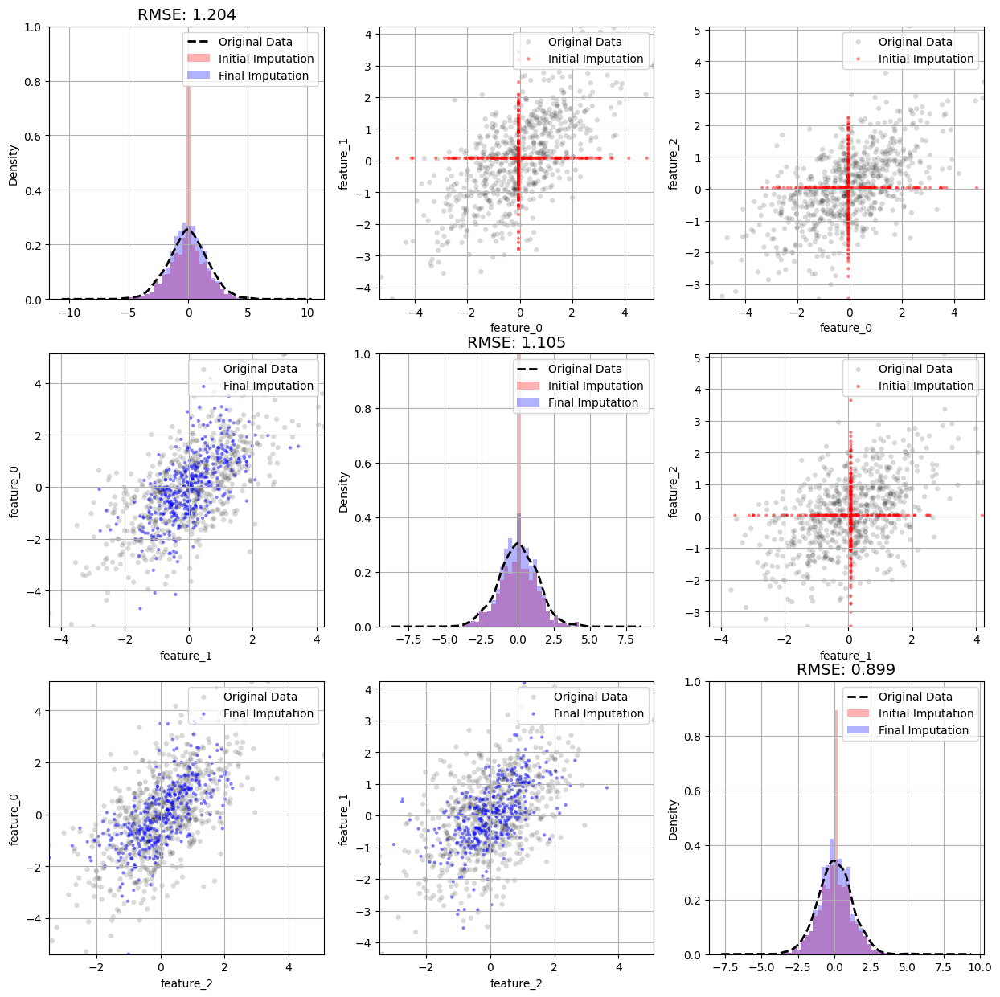

Iteration 126 - Current RMSE: feature_0: 1.204, feature_1: 1.105, feature_2: 0.899
Iteration 127 - Current RMSE: feature_0: 1.204, feature_1: 1.105, feature_2: 0.898
Iteration 128 - Current RMSE: feature_0: 1.203, feature_1: 1.105, feature_2: 0.898
Iteration 129 - Current RMSE: feature_0: 1.203, feature_1: 1.105, feature_2: 0.899
Iteration 130 - Current RMSE: feature_0: 1.203, feature_1: 1.105, feature_2: 0.899


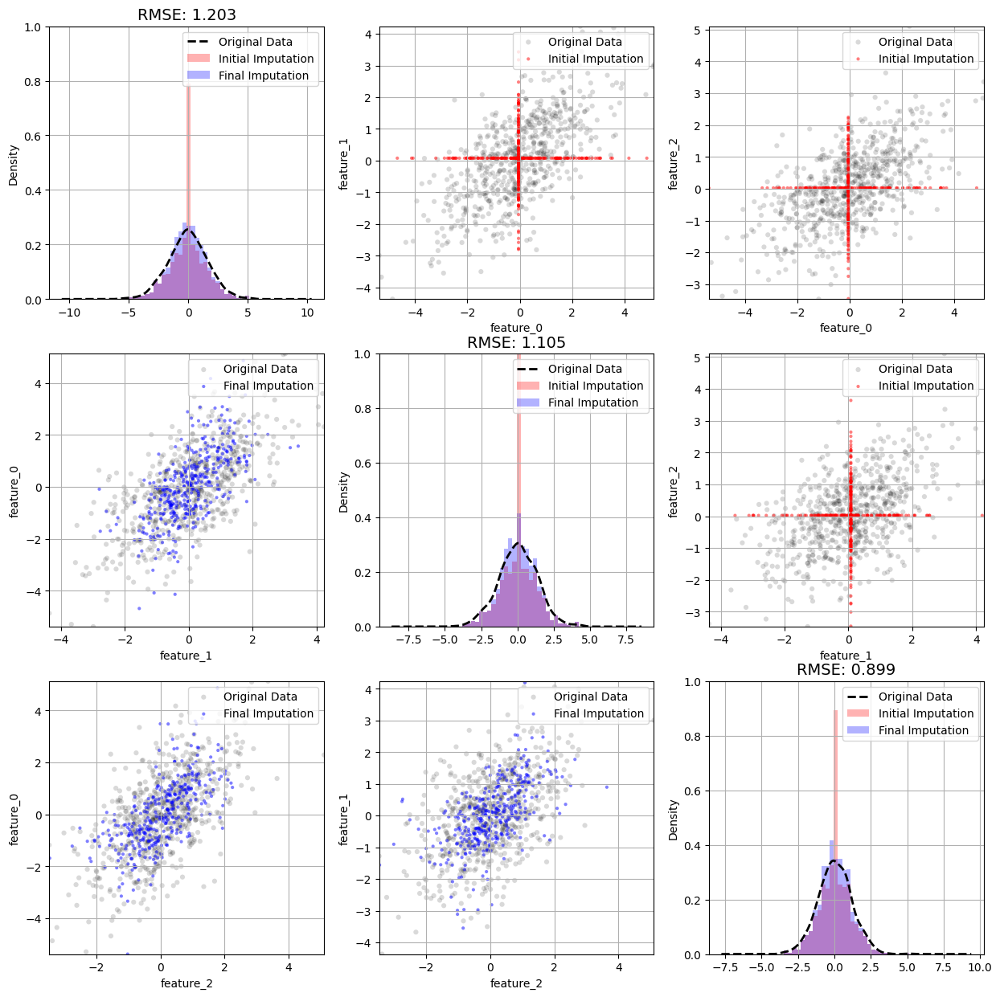

Iteration 131 - Current RMSE: feature_0: 1.203, feature_1: 1.105, feature_2: 0.899
Iteration 132 - Current RMSE: feature_0: 1.203, feature_1: 1.104, feature_2: 0.899
Iteration 133 - Current RMSE: feature_0: 1.203, feature_1: 1.104, feature_2: 0.899
Iteration 134 - Current RMSE: feature_0: 1.203, feature_1: 1.104, feature_2: 0.899
Iteration 135 - Current RMSE: feature_0: 1.203, feature_1: 1.103, feature_2: 0.900


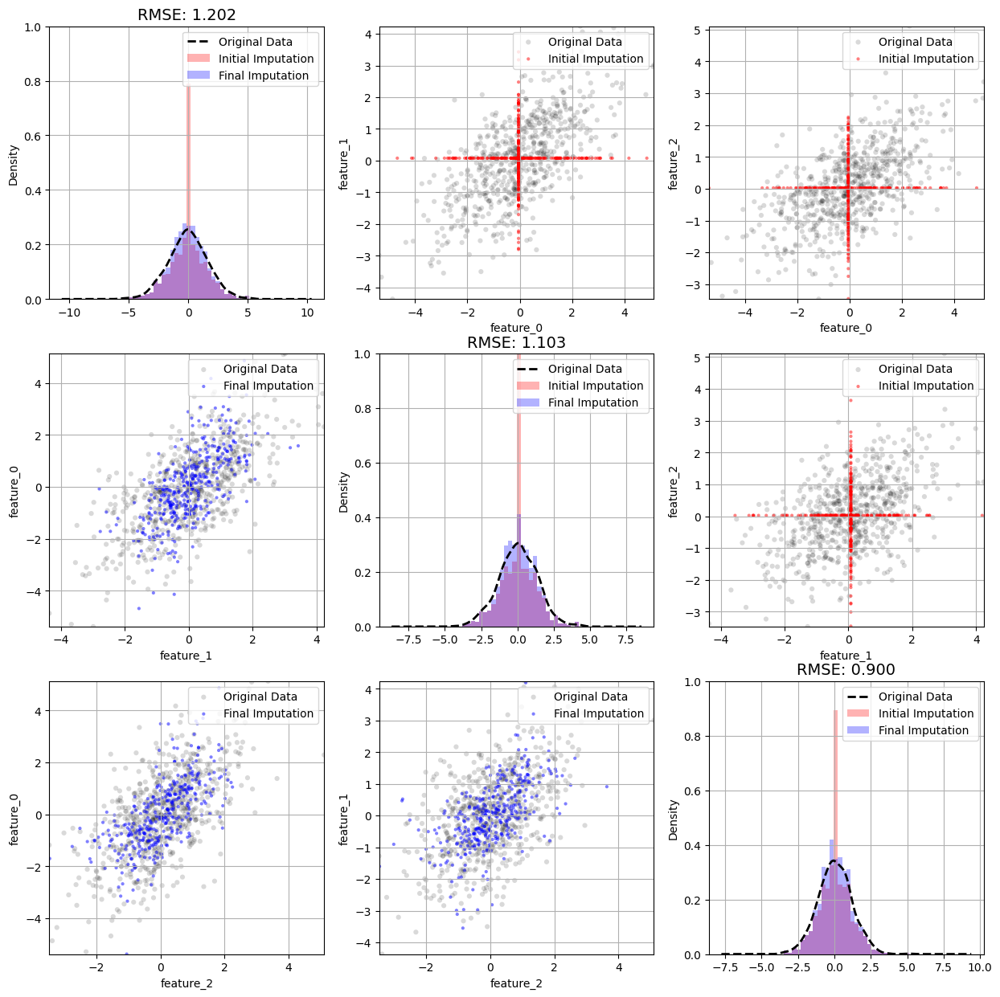

Iteration 136 - Current RMSE: feature_0: 1.202, feature_1: 1.103, feature_2: 0.900
Iteration 137 - Current RMSE: feature_0: 1.202, feature_1: 1.103, feature_2: 0.900
Iteration 138 - Current RMSE: feature_0: 1.202, feature_1: 1.103, feature_2: 0.900
Iteration 139 - Current RMSE: feature_0: 1.202, feature_1: 1.103, feature_2: 0.900
Iteration 140 - Current RMSE: feature_0: 1.202, feature_1: 1.103, feature_2: 0.900


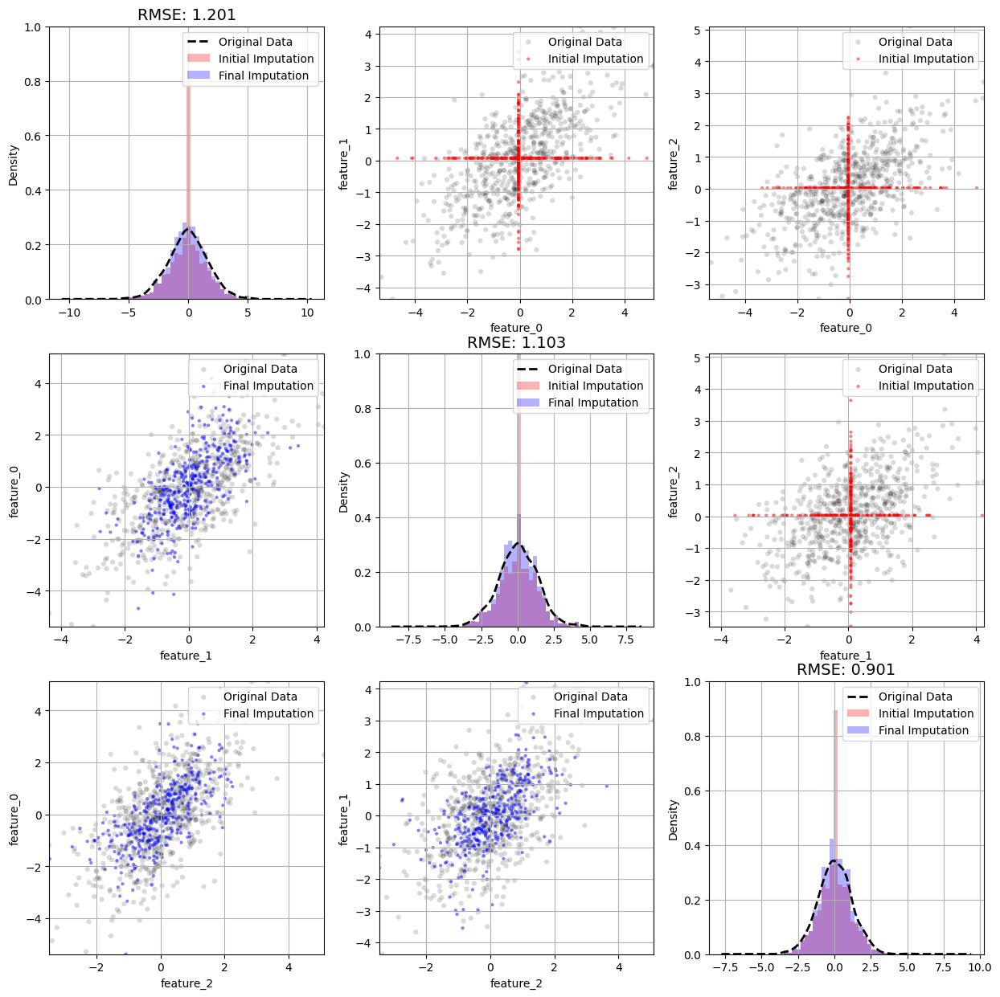

Iteration 141 - Current RMSE: feature_0: 1.201, feature_1: 1.103, feature_2: 0.901
Iteration 142 - Current RMSE: feature_0: 1.201, feature_1: 1.103, feature_2: 0.900
Iteration 143 - Current RMSE: feature_0: 1.201, feature_1: 1.102, feature_2: 0.900
Iteration 144 - Current RMSE: feature_0: 1.201, feature_1: 1.102, feature_2: 0.900
Iteration 145 - Current RMSE: feature_0: 1.201, feature_1: 1.102, feature_2: 0.900


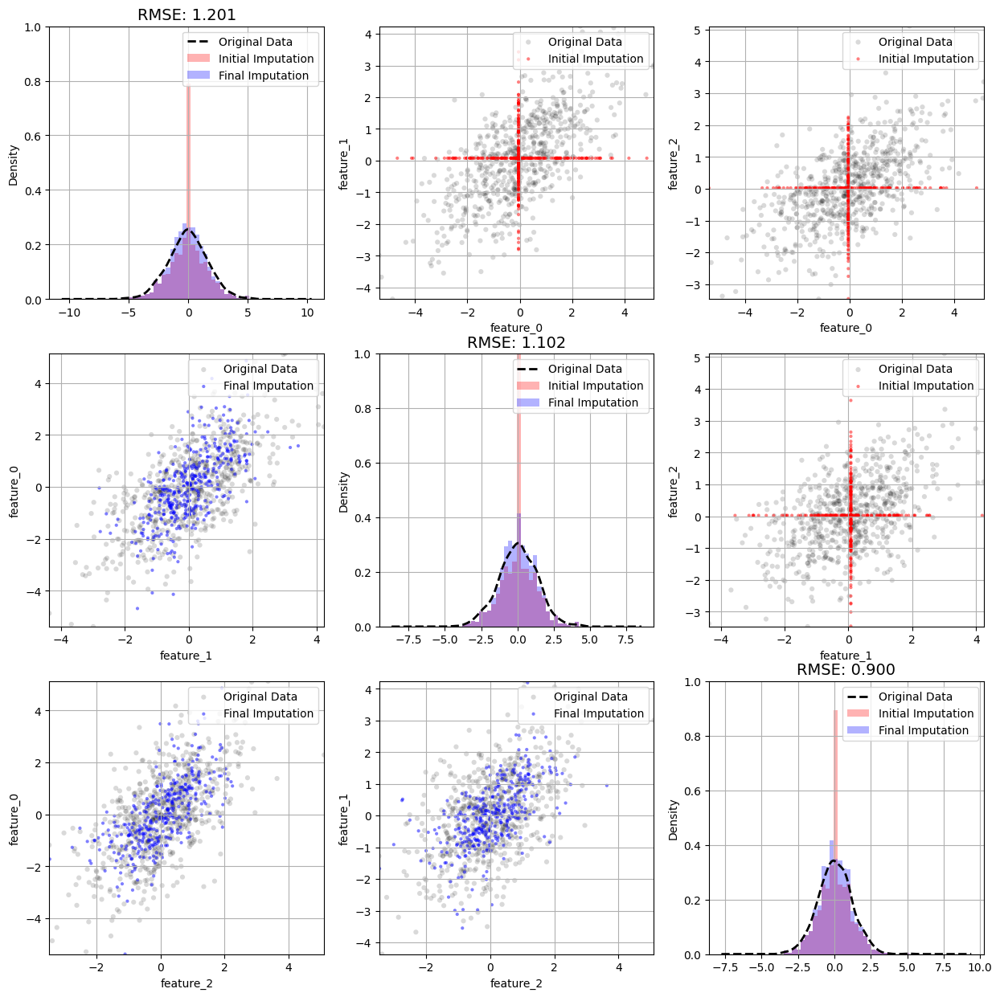

Iteration 146 - Current RMSE: feature_0: 1.201, feature_1: 1.102, feature_2: 0.900
Iteration 147 - Current RMSE: feature_0: 1.201, feature_1: 1.102, feature_2: 0.900
Iteration 148 - Current RMSE: feature_0: 1.201, feature_1: 1.102, feature_2: 0.901
Iteration 149 - Current RMSE: feature_0: 1.201, feature_1: 1.102, feature_2: 0.901
Iteration 150 - Current RMSE: feature_0: 1.201, feature_1: 1.102, feature_2: 0.901


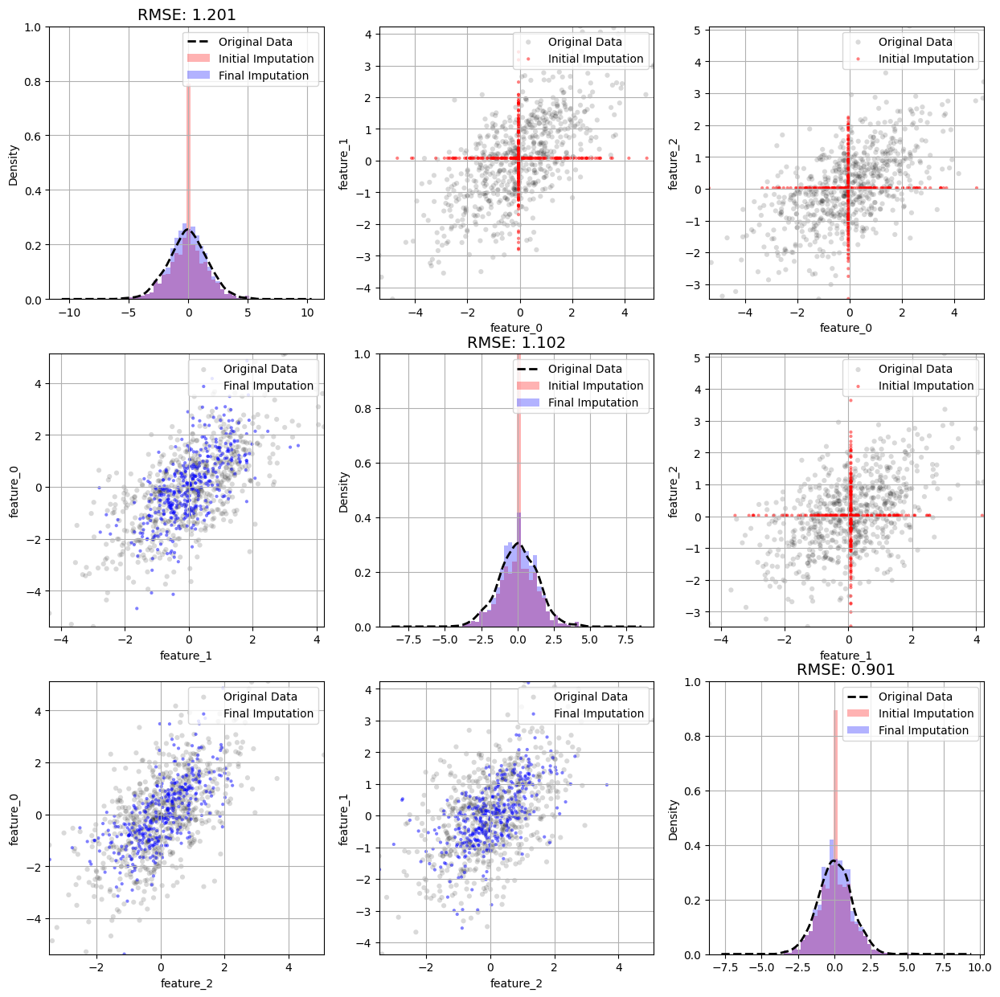

Iteration 151 - Current RMSE: feature_0: 1.201, feature_1: 1.102, feature_2: 0.901
Iteration 152 - Current RMSE: feature_0: 1.201, feature_1: 1.102, feature_2: 0.901
Iteration 153 - Current RMSE: feature_0: 1.200, feature_1: 1.102, feature_2: 0.901
Iteration 154 - Current RMSE: feature_0: 1.200, feature_1: 1.101, feature_2: 0.902
Iteration 155 - Current RMSE: feature_0: 1.200, feature_1: 1.101, feature_2: 0.901


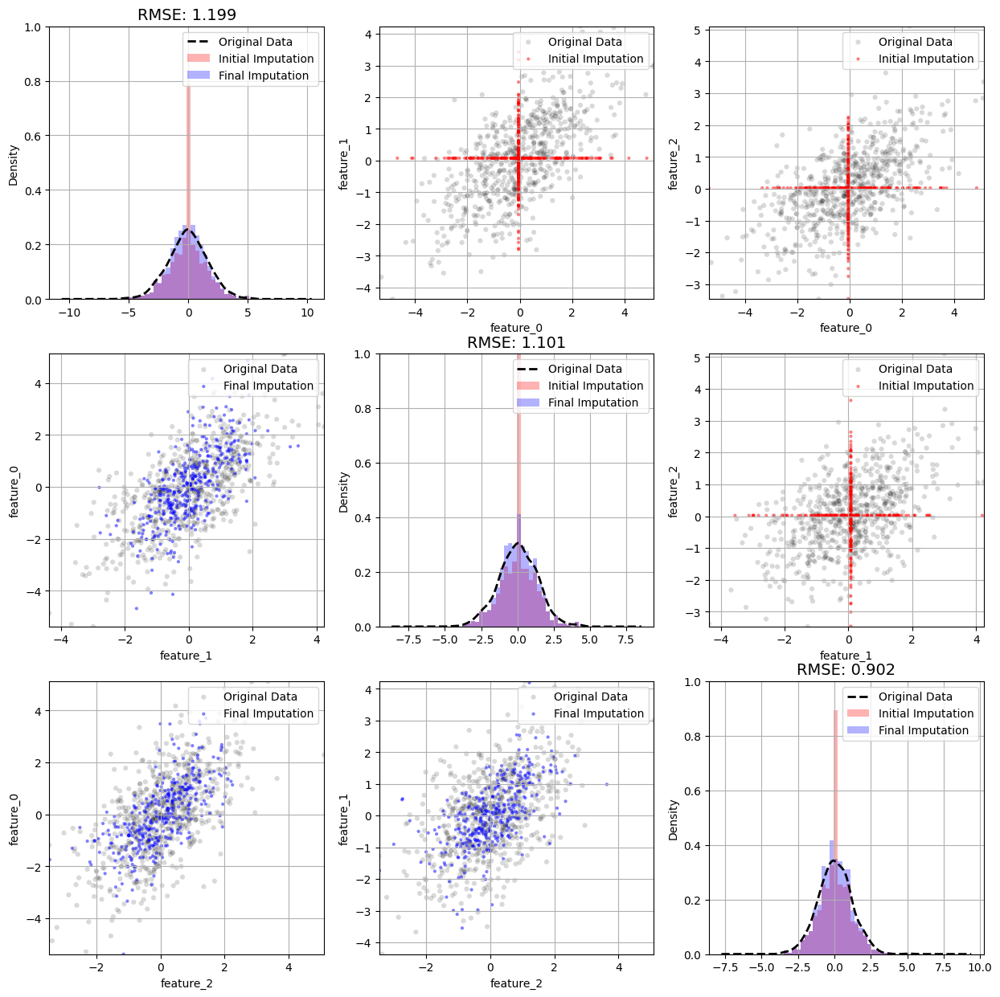

Iteration 156 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.902
Iteration 157 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.902
Iteration 158 - Current RMSE: feature_0: 1.199, feature_1: 1.102, feature_2: 0.902
Iteration 159 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.902
Iteration 160 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901


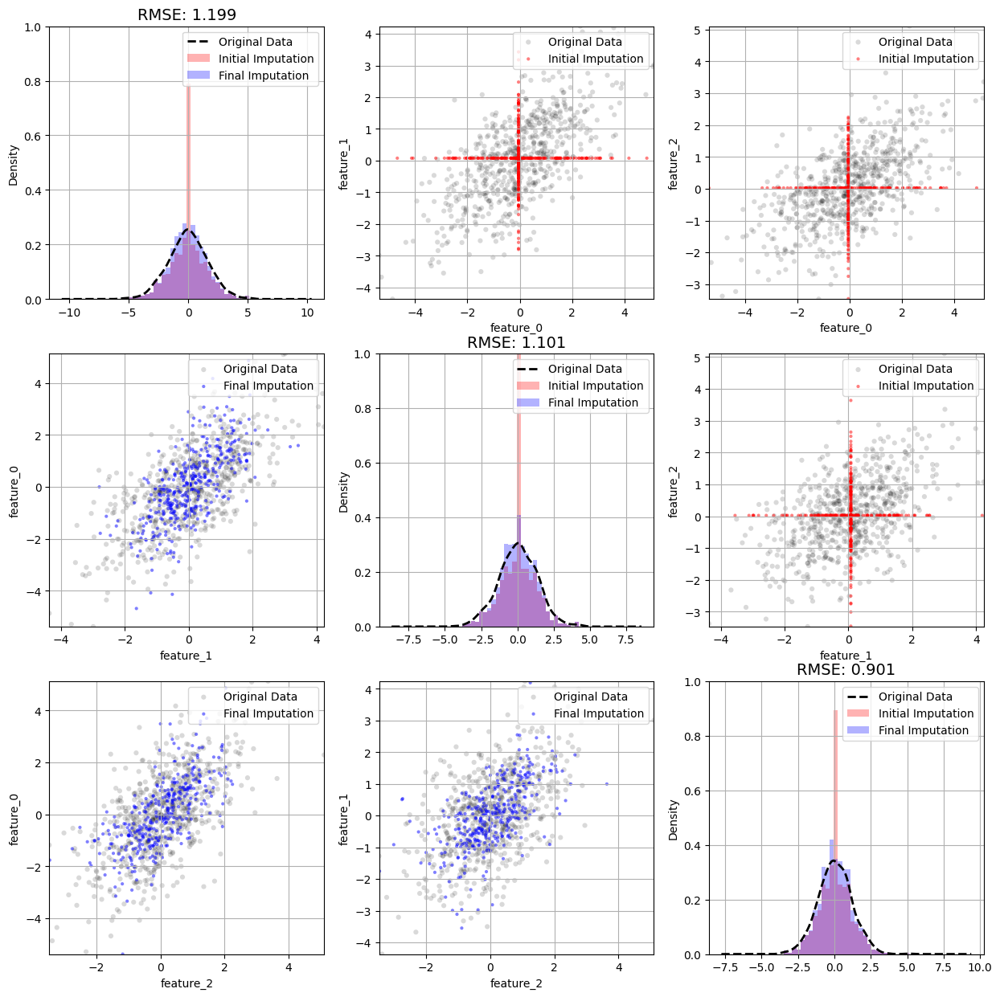

Iteration 161 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901
Iteration 162 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901
Iteration 163 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901
Iteration 164 - Current RMSE: feature_0: 1.198, feature_1: 1.100, feature_2: 0.901
Iteration 165 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.900


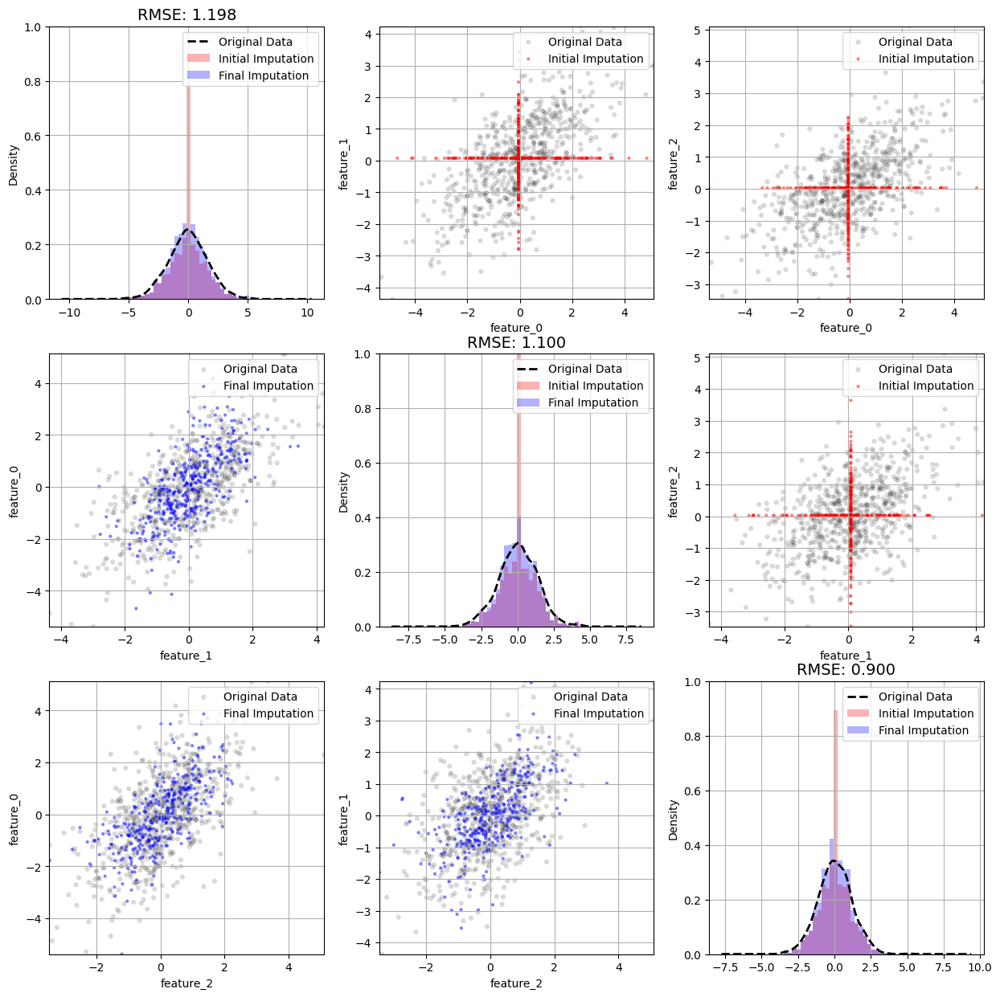

Iteration 166 - Current RMSE: feature_0: 1.198, feature_1: 1.100, feature_2: 0.900
Iteration 167 - Current RMSE: feature_0: 1.199, feature_1: 1.100, feature_2: 0.900
Iteration 168 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901
Iteration 169 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.901
Iteration 170 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.901


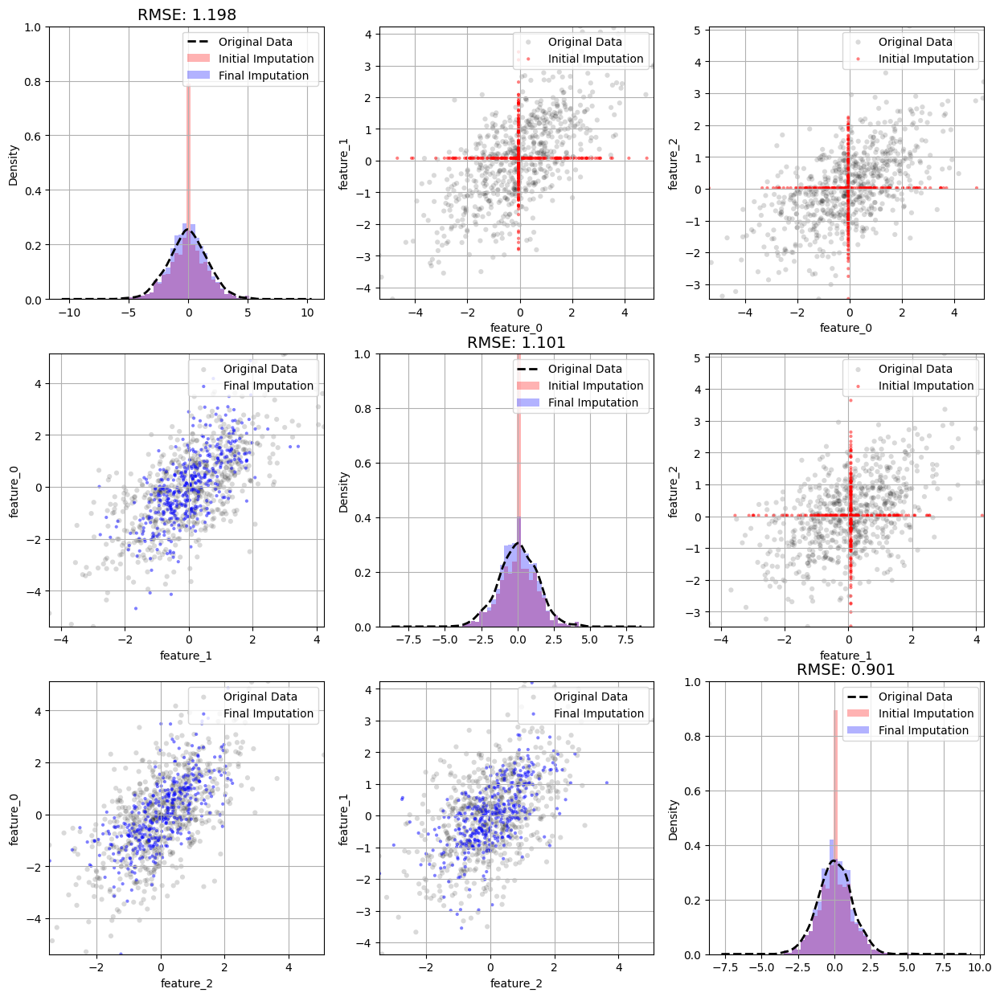

Iteration 171 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.901
Iteration 172 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.901
Iteration 173 - Current RMSE: feature_0: 1.198, feature_1: 1.100, feature_2: 0.901
Iteration 174 - Current RMSE: feature_0: 1.198, feature_1: 1.100, feature_2: 0.901
Iteration 175 - Current RMSE: feature_0: 1.198, feature_1: 1.100, feature_2: 0.901


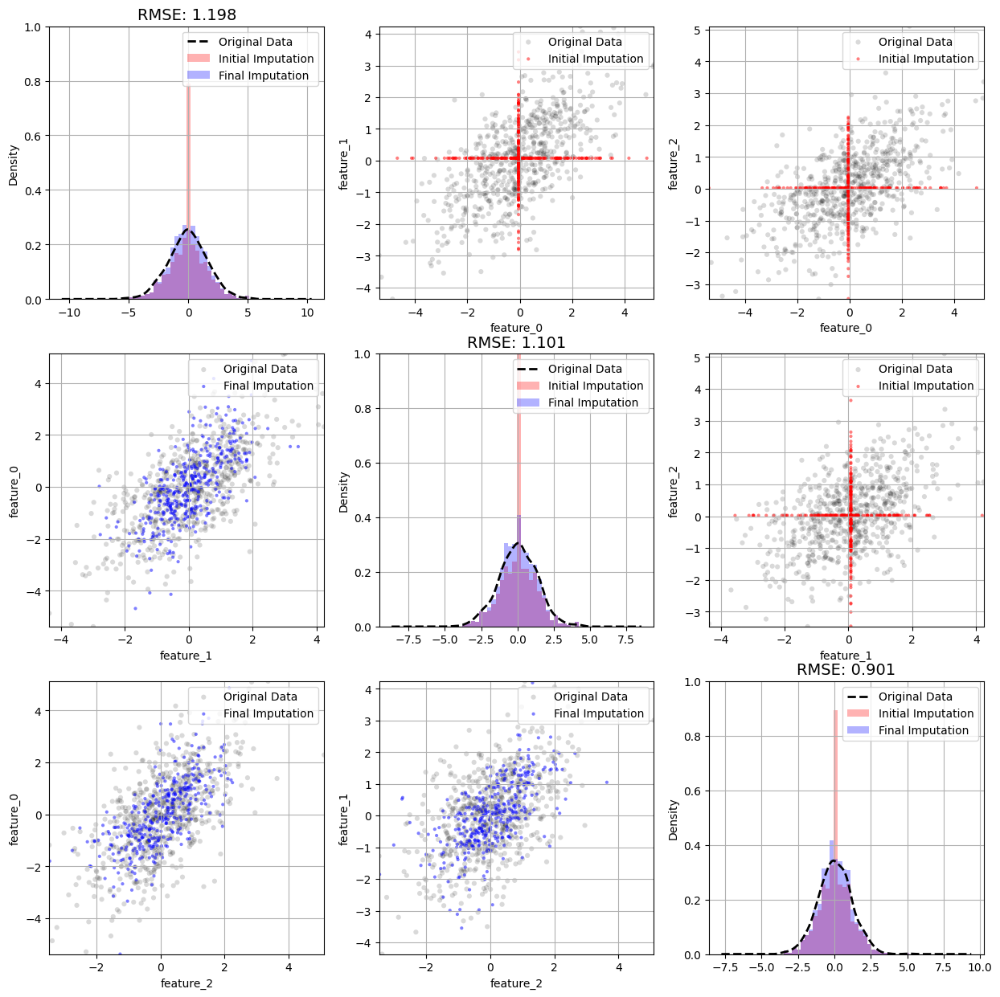

Iteration 176 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.901
Iteration 177 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901
Iteration 178 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901
Iteration 179 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.901
Iteration 180 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901


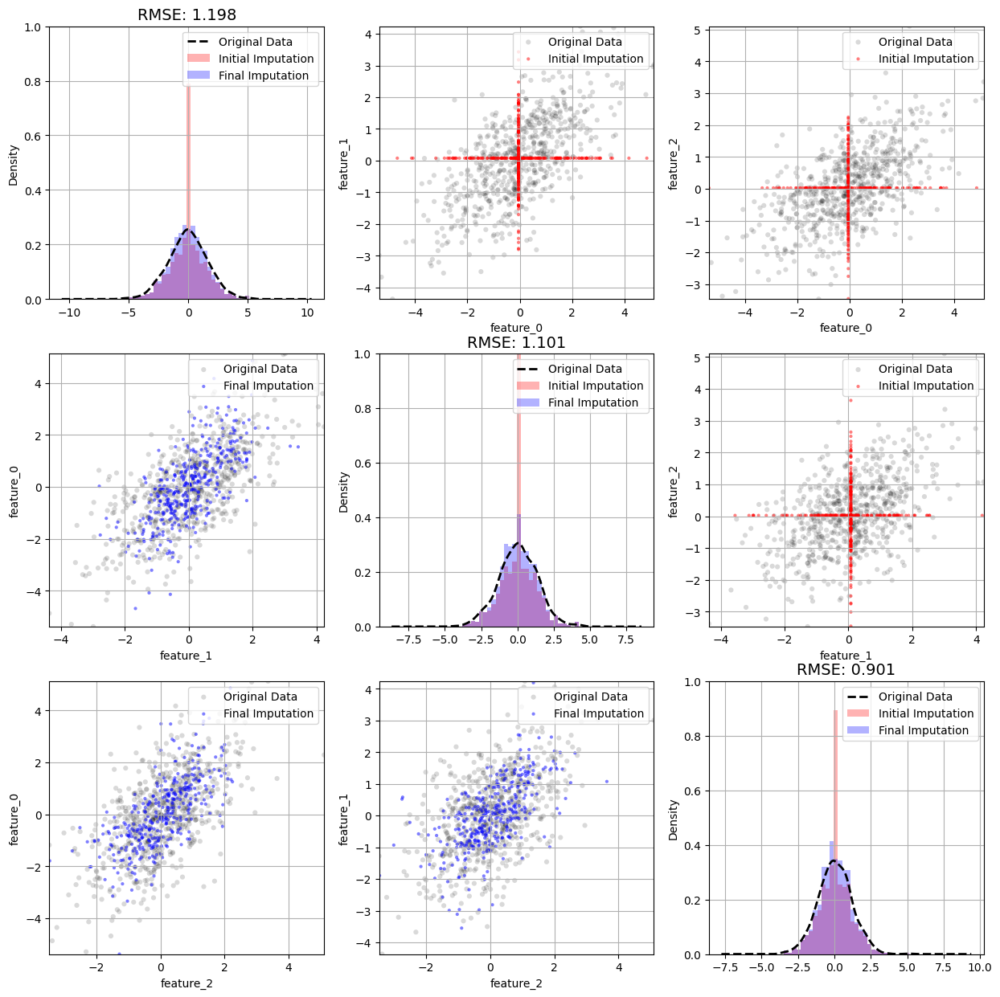

Iteration 181 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.901
Iteration 182 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901
Iteration 183 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901
Iteration 184 - Current RMSE: feature_0: 1.199, feature_1: 1.101, feature_2: 0.901
Iteration 185 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.902


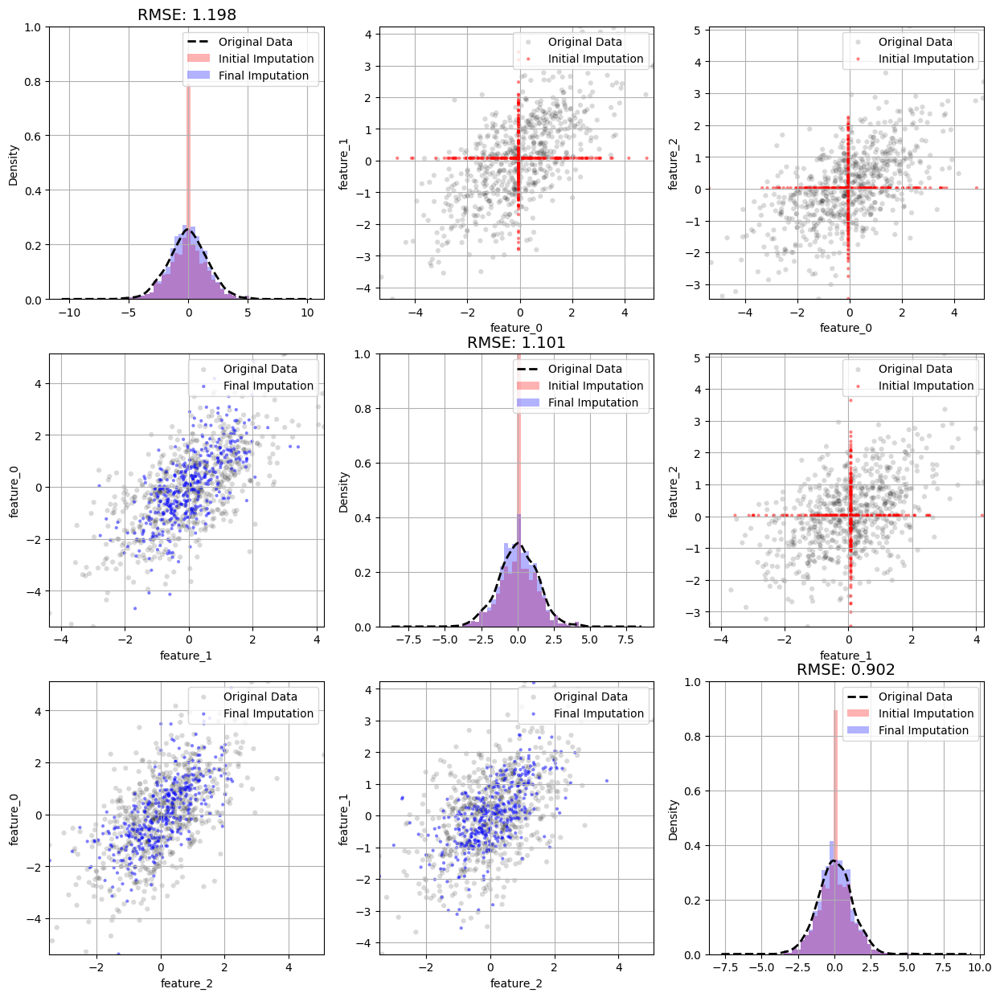

Iteration 186 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.902
Iteration 187 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.902
Iteration 188 - Current RMSE: feature_0: 1.198, feature_1: 1.102, feature_2: 0.902
Iteration 189 - Current RMSE: feature_0: 1.198, feature_1: 1.102, feature_2: 0.902
Iteration 190 - Current RMSE: feature_0: 1.198, feature_1: 1.101, feature_2: 0.902


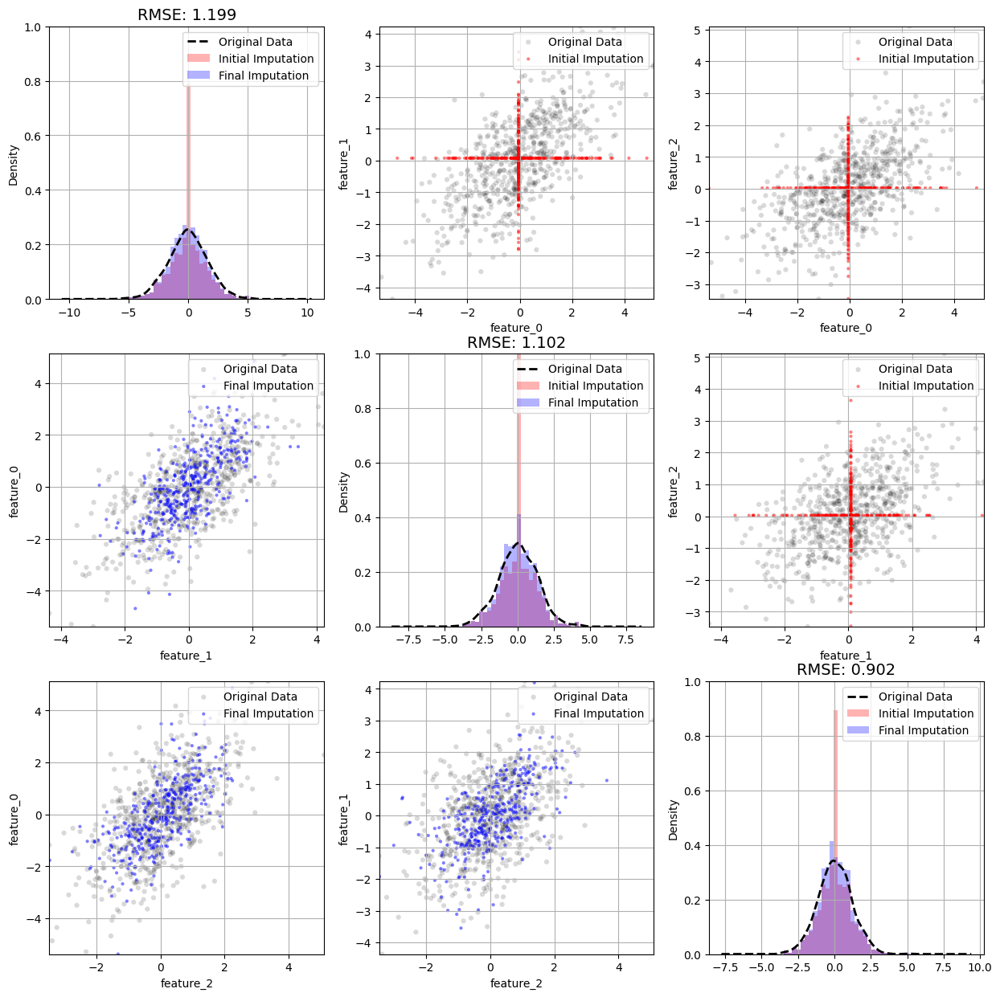

Iteration 191 - Current RMSE: feature_0: 1.199, feature_1: 1.102, feature_2: 0.902
Iteration 192 - Current RMSE: feature_0: 1.199, feature_1: 1.102, feature_2: 0.902
Iteration 193 - Current RMSE: feature_0: 1.199, feature_1: 1.102, feature_2: 0.902
Iteration 194 - Current RMSE: feature_0: 1.199, feature_1: 1.102, feature_2: 0.902
Iteration 195 - Current RMSE: feature_0: 1.198, feature_1: 1.103, feature_2: 0.902


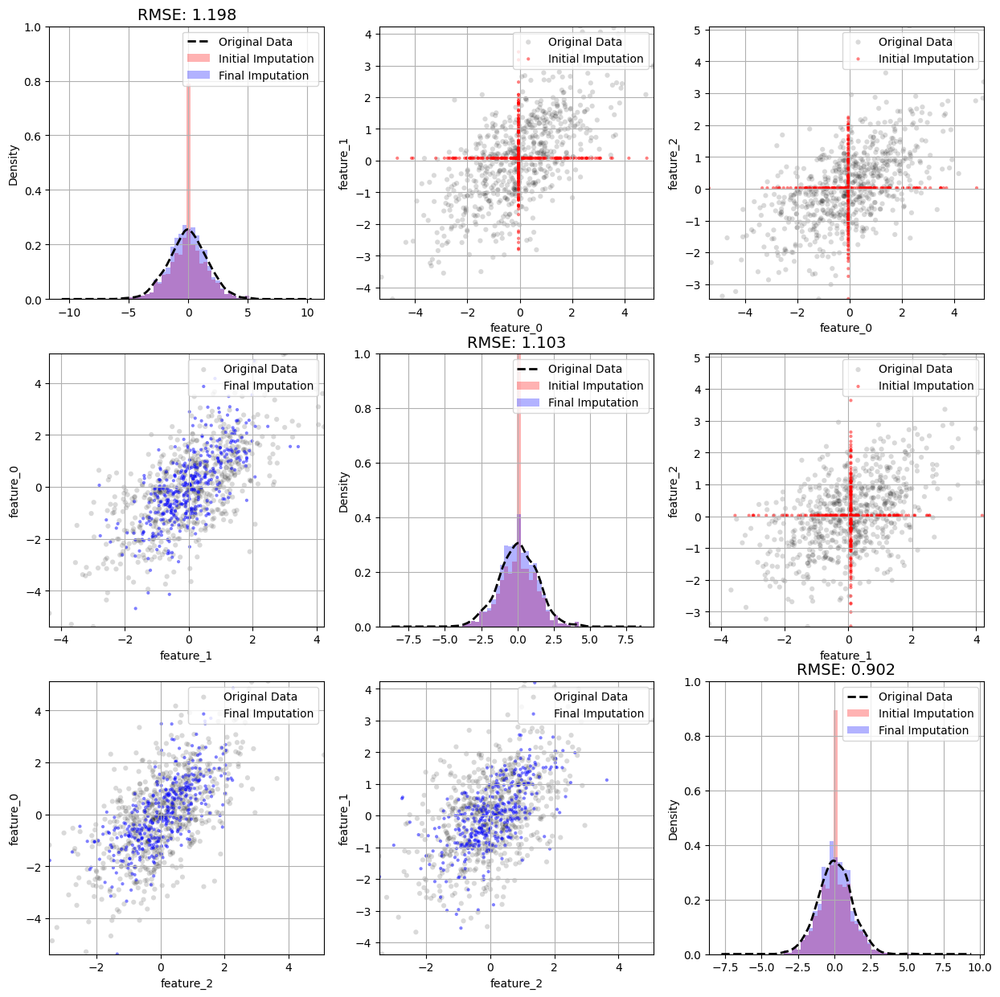

Iteration 196 - Current RMSE: feature_0: 1.198, feature_1: 1.103, feature_2: 0.902
Iteration 197 - Current RMSE: feature_0: 1.198, feature_1: 1.103, feature_2: 0.902
Iteration 198 - Current RMSE: feature_0: 1.198, feature_1: 1.103, feature_2: 0.902
Iteration 199 - Current RMSE: feature_0: 1.198, feature_1: 1.103, feature_2: 0.902
Iteration 200 - Current RMSE: feature_0: 1.198, feature_1: 1.103, feature_2: 0.902


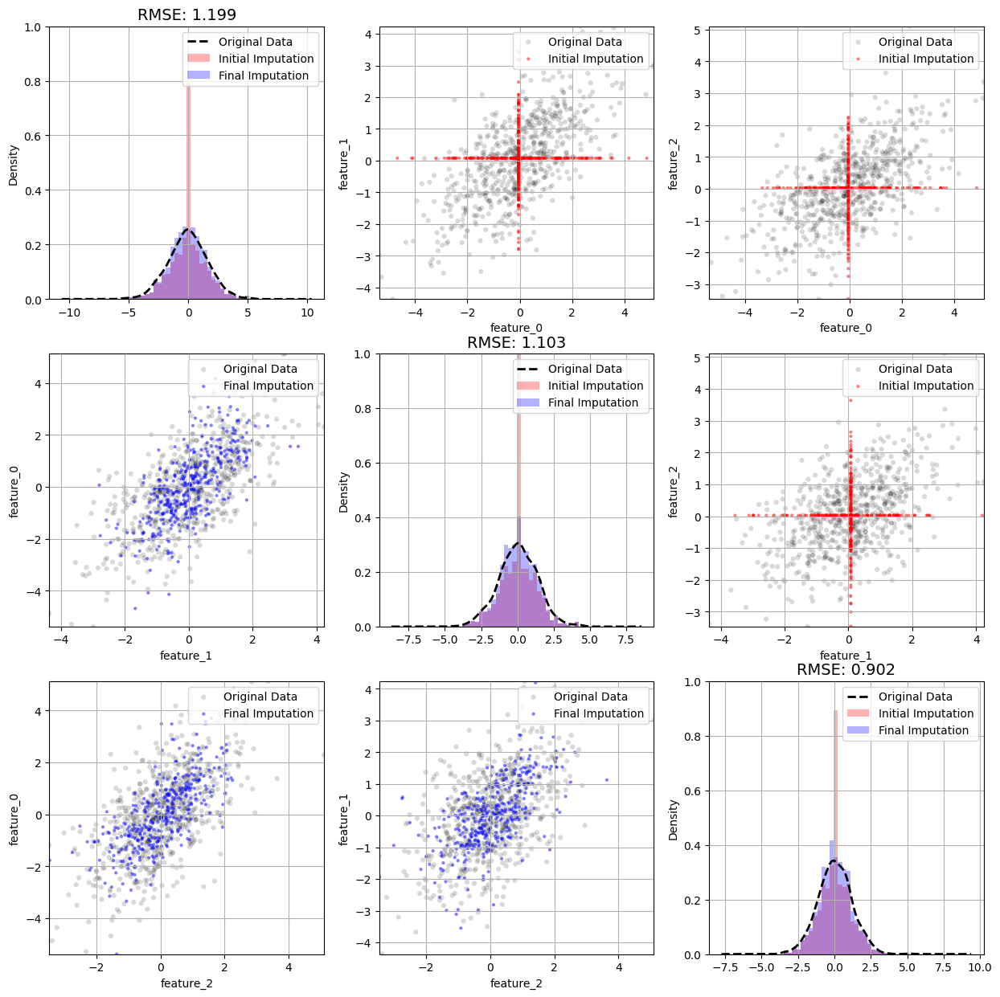

In [13]:
# rmse_s = {
#     'feature_0':[],
#     'feature_1':[],
#     'feature_2':[]
# }
for i in range(100, 201):
    rmse_s['feature_0'] += [get_rmse(rawdf, imputed_df2, missing_mask, 'feature_0')]
    rmse_s['feature_1'] += [get_rmse(rawdf, imputed_df2, missing_mask, 'feature_1')]
    rmse_s['feature_2'] += [get_rmse(rawdf, imputed_df2, missing_mask, 'feature_2')]
    
    print(f"Iteration {i} - Current RMSE: feature_0: {get_rmse(rawdf, imputed_df2, missing_mask, 'feature_0'):.3f}, feature_1: {get_rmse(rawdf, imputed_df2, missing_mask, 'feature_1'):.3f}, feature_2: {get_rmse(rawdf, imputed_df2, missing_mask, 'feature_2'):.3f}")

    models = train_catboost_model(imputed_df2, missing_mask)
    imputed_df2 = impute_with_trained_model(imputed_df2, missing_mask, models)

    if i % 5 == 0:
        plot_scatter_matrix(df, imputed_df, imputed_df2, n_features=3, bins=30, figsize=(15, 15), actual_df=rawdf)

In [12]:
rmse_s = pd.DataFrame(rmse_s)
rmse_s.to_parquet('rmse.parquet')